# setup

In [1]:
import os
import scipy.io
import pandas as pd
import numpy as np
import math
import re
import matplotlib.pyplot as plt
import seaborn as sns
import arviz as az
from scipy.signal import medfilt
from scipy import stats
from scipy.stats import sem
import pickle
import matplotlib.patches as patches

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
az.style.use("arviz-white") 

In [3]:
# choose if you want to save all data for statistical analysis
SaveAllData = True  # True False

# Load data

In [4]:
# Define the output folder for saving figures
output_folder = 'D:/4Lab/eye_hand_8tarLppt/checkSubj'
# Define the path to the hand data folder
hand_location = 'D:/4Lab/eye_hand_8tarLppt/data/hand_keep'
# Define the path to the eye data folder
eye_location = 'D:/4Lab/eye_hand_8tarLppt/data/eye_keep'

# Function to read hand data
def read_hand_data(hand_export):
    target_columns = ['target_x', 'target_y', 'baseline', 'rotation', 'aftereffect', 'RT',
                      'movement_frames', 'MoveOnsetTime1', 'MoveEndTime1', 'HandTrialStart',
                      'baseline_trials.thisN', 'rotation_trials.thisN', 'aftereffect_trials.thisN', 'group']
    hand_df = pd.read_csv(hand_export)[target_columns].iloc[10:].dropna(subset=['target_x']).reset_index(drop=True)
    return hand_df

# Function to read eye annotation data
def read_eye_annotation(eye_export_annotation):
    eye_annotation = pd.read_csv(eye_export_annotation)[['timestamp', 'label']]
    return eye_annotation

# Function to read eye gaze data
def read_eye_gaze(eye_export_gaze):
    eye_gaze = pd.read_csv(eye_export_gaze)[['gaze_timestamp', 'world_timestamp', 'x_norm', 'y_norm', 'on_surf', 'confidence']]
    return eye_gaze

# Dictionary to store data for each subject
all_data = {}
# List to store IDs of the subjects read
all_subjects_id = []

# Loop over all files in hand location
for hand_file in os.listdir(hand_location):
    if hand_file.endswith('.csv'):
        # Extract subject ID from the file name
        subj_id = hand_file.split('_')[0]
        # Define the path to hand export file
        hand_export = os.path.join(hand_location, hand_file)
        # Define the path to eye annotation file
        eye_export_annotation = os.path.join(eye_location, subj_id, 'annotations.csv')
        # Define the path to eye gaze file
        eye_export_gaze = os.path.join(eye_location, subj_id, 'gaze_positions_on_surface_screen.csv')
        # Read hand data
        hand = read_hand_data(hand_export)
        # Read eye annotation data
        eye_annotation = read_eye_annotation(eye_export_annotation)
        # Read eye gaze data
        eye_gaze = read_eye_gaze(eye_export_gaze)
        # Store data for the subject
        all_data[subj_id] = {'hand': hand, 'eye_annotation': eye_annotation, 'eye_gaze': eye_gaze}
        # Record the ID of the subject read
        all_subjects_id.append(subj_id)

# Print the IDs of the subjects read
print("Read data for subjects:", all_subjects_id)

Read data for subjects: ['16', '17', '19', '20', '22', '23', '24', '25', '26', '28', '29', '30', '32', '33', '34', '35', '36', '37', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51']


In [5]:
# Define scales for data
# Cut hand data from 2.5 second before movement onset to 1.5 seconds after
# movmement onset. This should be enough to capture both the origin hold
# and the feedback.
t_min = -2.5
t_max = 1.5
dt = 0.01  # We'll resample everything to 10 ms sampling
t_vals = np.arange(t_min, t_max + dt, dt)
num_t_vals = len(t_vals)
num_coord = 2
num_trials = int(hand['baseline'].sum() + hand['rotation'].sum() + hand['aftereffect'].sum())
# Get the number of subjects
num_subjects = len(all_data)
# Get target
target = hand[['target_x', 'target_y']].values

# Units are image width/height in a normalized coordinate system 
# with 0,0 origin in the bottom left and 1,1 at top right (pupil labs docs)
# screen is 53*30 cm 
# https://docs.pupil-labs.com/core/terminology/#coordinate-system
screen_width = 53
screen_height = 30
# The eye starts from the bottom left of the screen and has normalized
# coordinates over the screen.
x0_eye = 0.5
y0_eye = 0.5
x_unit_eye = screen_width
y_unit_eye = screen_height

# Determine a confidence threshold for the gaze data
confidence_threshold = 0.9

# Hand data process

In [6]:
# Extracts coordinate points from a hand position string.
def extract_hand_position(string):
    # find numbers part in string
    numbers = re.findall(r'[-+]?\d*\.\d+|\d+', string)
    # Convert strings to floats
    numbers = [float(num) for num in numbers]
    # Convert to array
    num_array = np.array(numbers)
    # Reshape to 2D array with each row representing a coordinate pair
    hand_position = num_array.reshape(-1, 2)
    return hand_position

# Rotates coordinates counter-clockwise around the origin.
def rotate_point(point, angle):
    # Convert angle to radians
    angle_rad = np.radians(angle)
    # Create rotation matrix
    rotation_matrix = np.array([[np.cos(angle_rad), -np.sin(angle_rad)],
                                 [np.sin(angle_rad), np.cos(angle_rad)]])
    # Perform matrix multiplication to rotate coordinates
    rotated_point = np.dot(rotation_matrix, point)
    return rotated_point

In [7]:
# Loop over all subjects in all_data
for subj_id in all_data.keys():
    hand_df = all_data[subj_id]['hand']  
    # Extracting target coordinates
    target_x = hand_df['target_x']
    target_y = hand_df['target_y']
    target = np.column_stack((target_x, target_y))
    theta = np.arctan2(target_y, target_x)
    target_rotate_angle = np.degrees(theta)
    # Ensure angle is within range [0, 360)
    target_rotate_angle = np.mod(90 - target_rotate_angle, 360)   
    # get raw hand
    raw_hand = hand_df['movement_frames'].apply(extract_hand_position)
    # rotate raw hand
    rotated_hand = []
    for i in range(len(raw_hand)):
        trial_points = raw_hand[i]
        angle = target_rotate_angle[i]
        rotated_trial_points = []

        for point in trial_points:
            rotated_point = rotate_point(point, angle)
            rotated_trial_points.append(rotated_point)
        rotated_hand.append(rotated_trial_points)
    
    # Store rotated hand data for the subject in all_data
    all_data[subj_id]['raw_hand'] = raw_hand
    all_data[subj_id]['rotated_hand'] = rotated_hand

# Eye data process

In [8]:
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():
    # Get the data for the current subject
    eye_annotation = all_data[subj_id]['eye_annotation']
    eye_gaze = all_data[subj_id]['eye_gaze']
    
    # Find 'start_experiment' and 'start_trial 10' indices
    if 'start_experiment' in eye_annotation['label'].values:
        idx_experiment_start = eye_annotation.index[eye_annotation['label'] == 'start_experiment'][0]
    else:
        idx_experiment_start = 0
#     idx_experiment_start = eye_annotation.index[eye_annotation['label'] == 'start_experiment'][0]
    idx_trial_10 = eye_annotation.index[eye_annotation['label'] == 'start_trial 10'][0]

    # Delete data after 'start_experiment' and before 'start_trial 10'
    eye_annotation = eye_annotation.drop(index=eye_annotation.index[1:idx_trial_10])
    eye_gaze = eye_gaze.drop(index=eye_gaze.index[1:idx_trial_10])

    # Find trial start and end indices
    trialStartLabels = eye_annotation.index[eye_annotation['label'].str.startswith("start_trial")]
    trialEndLabels = eye_annotation.index[eye_annotation['label'].str.startswith("end_trial")]
    movementStartLabels = eye_annotation.index[eye_annotation['label'].str.startswith("move_start")]
    movementEndLabels = eye_annotation.index[eye_annotation['label'].str.startswith("move_end")]

    # Get timestamps for trial and movement starts/ends
    trialStarts = eye_annotation.loc[trialStartLabels, 'timestamp'].values
    trialEnds = eye_annotation.loc[trialEndLabels, 'timestamp'].values
    movementStarts = eye_annotation.loc[movementStartLabels, 'timestamp'].values
    movementEnds = eye_annotation.loc[movementEndLabels, 'timestamp'].values

    # Keep rows where 'on_surf' column is True
    eye_gaze = eye_gaze[eye_gaze['on_surf'] == True]

    # Initialize an array to store gaze data for each trial
    gaze = np.nan * np.zeros((len(t_vals), num_trials, num_coord))

    # Process gaze data for each trial
    for trialNum in range(num_trials):
        thisStartTime = trialStarts[trialNum]
        thisEndTime = trialEnds[trialNum]
        thisMoveStartTime = movementStarts[trialNum]
        thisMoveEndTime = movementEnds[trialNum]

        # Filter gaze data within trial time range and with sufficient confidence
        mask = (eye_gaze['gaze_timestamp'] > (thisMoveStartTime-3.0)) & \
               (eye_gaze['gaze_timestamp'] < (thisMoveStartTime+2)) & \
               (eye_gaze['confidence'] > confidence_threshold) 
        theseGazeT = eye_gaze.loc[mask, 'gaze_timestamp'].values
        theseGazeX = eye_gaze.loc[mask, 'x_norm'].values
        theseGazeY = eye_gaze.loc[mask, 'y_norm'].values

        # Remove bad samples
        badSample = np.where(np.diff(theseGazeT) <= 0)[0]
        while len(badSample) > 0:
            keepSample = np.setdiff1d(np.arange(len(theseGazeT)), badSample + 1)
            theseGazeT = theseGazeT[keepSample]
            theseGazeX = theseGazeX[keepSample]
            theseGazeY = theseGazeY[keepSample]
            badSample = np.where(np.diff(theseGazeT) <= 0)[0]
            
        # Adjust timestamps to make thisMoveStartTime the zero point
        theseGazeTZeroed = (theseGazeT - thisMoveStartTime)
        
        # Interpolate gaze data to match time values
        if len(theseGazeT) > 1:
            x = np.interp(t_vals, theseGazeTZeroed, theseGazeX, left=np.nan, right=np.nan)
            y = np.interp(t_vals, theseGazeTZeroed, theseGazeY, left=np.nan, right=np.nan)
            gaze[:, trialNum, 0] = (x - x0_eye) * x_unit_eye
            gaze[:, trialNum, 1] = (y - y0_eye) * y_unit_eye
        else:
            gaze[:, trialNum, :] = np.nan * np.zeros((len(t_vals), num_coord))
            
    all_data[subj_id]['gaze'] = gaze

In [9]:
# Zero-correct: Correct based on gaze at the origin        
# Calculate the mean of the gaze points between the 60th and 90th points
originMin = -2.0
originMax = -1.7
span = 25 
# Find indices for the period of looking at the origin
tOr = np.where((originMin < t_vals) & (t_vals < originMax))[0]

for subj_id in all_data.keys():
    gazeThisS = all_data[subj_id]['gaze']
    # Get median position of eyes at origin fixation
    gOr = np.nanmedian(gazeThisS[tOr,:,:], axis=0)

    # Fill outliers of gOr
    gOr[:,0] = medfilt(gOr[:,0], kernel_size=span)  # Applying median filter for outlier removal
    gOr[:,1] = medfilt(gOr[:,1], kernel_size=span)

    # Shift the data so the smoothed 0 is 0
    corrected_gaze = gazeThisS - np.expand_dims(gOr, axis=0)
    gShift = np.nanmedian(corrected_gaze[tOr, :, :], axis=0)  # the position where the eyes look at the origin after correction

    all_data[subj_id]['raw_gaze'] = corrected_gaze

D:\anaconda3\envs\eyehand3\lib\site-packages\numpy\lib\nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


In [10]:
# Function to rotate points
def rotate_points(x, y, angle):
    radians = np.deg2rad(angle)
    cos_angle = np.cos(radians)
    sin_angle = np.sin(radians)
    x_rotated = cos_angle * x - sin_angle * y
    y_rotated = sin_angle * x + cos_angle * y
    return x_rotated, y_rotated

# Function to get the rotation angle for each target point to align with (0, 12)
def get_rotation_angle(target):
    target_x, target_y = target
    angle = np.arctan2(target_x, target_y)
    angle_deg = np.degrees(angle)
    return angle_deg

In [11]:
for subj_id in all_data.keys():
    corrected_gazeThisS = all_data[subj_id]['raw_gaze']
    target = all_data[subj_id]['hand'][['target_x', 'target_y']].values
    # Rotate corrected_gaze to  y axis
    gRotated = np.zeros_like(corrected_gazeThisS) 
    for trialNum in range(num_trials):  
        angle = get_rotation_angle(target[trialNum])     
        x_rotated, y_rotated = rotate_points(corrected_gazeThisS[:, trialNum, 0], corrected_gazeThisS[:, trialNum, 1], angle)
        gRotated[:, trialNum, 0] = x_rotated
        gRotated[:, trialNum, 1] = y_rotated
    all_data[subj_id]['rotated_gaze'] = gRotated

# Hand angle calculation

In [12]:
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():
    
    # Get the data for the current subject
    raw_hand = all_data[subj_id]['raw_hand']
    hand_df = all_data[subj_id]['hand']
    
    # Initialize EndAngle array
    EndAngle = np.zeros(num_trials)
    
    # Initialize counter for trials with distance < 3 cm
    count_distance_less_than_3 = 0

    # Calculate EndAngle for each trial
    for trialNum in range(num_trials):

        # Get the coordinates for the start and end of the hand movement
        startX = raw_hand[trialNum][0][0]  # Starting X position
        startY = raw_hand[trialNum][0][1]  # Starting Y position
        lastIndex = len(raw_hand[trialNum])
        handEndX = raw_hand[trialNum][lastIndex - 1][0]  # Ending X position
        handEndY = raw_hand[trialNum][lastIndex - 1][1]  # Ending Y position
        
        # Calculate distance from start to end position
        distance_to_start = np.sqrt(handEndX**2 + handEndY**2)
        # Check if the distance is less than 3 cm
        if distance_to_start < 3:
            EndAngle[trialNum] = np.nan
            count_distance_less_than_3 += 1
            continue
        
        # Target coordinates
        tx = target[trialNum][0]
        ty = target[trialNum][1]

        # Calculate angles relative to the start position
        TargetTheta = np.arctan2(ty - startY, tx - startX)  # Angle from start to target
        EndTheta = np.arctan2(handEndY - startY, handEndX - startX)  # Angle from start to end position

        if np.isnan(EndTheta):
            EndAngle[trialNum] = np.nan
        else:
            EndAngle[trialNum] = np.rad2deg(np.angle(np.exp(1j * (TargetTheta - EndTheta))))
    
    # Calculate the proportion of trials with distance < 3 cm
    proportion_less_than_3 = count_distance_less_than_3 / num_trials
    
    # Correct using mean of baseline
    mBase = np.nanmean(EndAngle[:int(np.sum(hand_df['baseline'])) - 1])
    handError = EndAngle - mBase

    # Smooth using median filter
    window_length = 27  # Should be an odd number
    sm_handError = medfilt(handError, kernel_size=window_length)
    
    # Store hand data for the subject in all_data
    all_data[subj_id]['handError'] = handError
    all_data[subj_id]['sm_handError'] = sm_handError
    all_data[subj_id]['proportion_less_than_3'] = proportion_less_than_3
  
 # Output the proportion for each subject
for subj_id in all_data.keys():
    print(f"Subject {subj_id}: Proportion of trials with distance < 3 cm: {all_data[subj_id]['proportion_less_than_3']:.2%}")

Subject 16: Proportion of trials with distance < 3 cm: 21.00%
Subject 17: Proportion of trials with distance < 3 cm: 6.50%
Subject 19: Proportion of trials with distance < 3 cm: 10.00%
Subject 20: Proportion of trials with distance < 3 cm: 13.00%
Subject 22: Proportion of trials with distance < 3 cm: 16.50%
Subject 23: Proportion of trials with distance < 3 cm: 9.00%
Subject 24: Proportion of trials with distance < 3 cm: 13.50%
Subject 25: Proportion of trials with distance < 3 cm: 5.50%
Subject 26: Proportion of trials with distance < 3 cm: 0.50%
Subject 28: Proportion of trials with distance < 3 cm: 0.50%
Subject 29: Proportion of trials with distance < 3 cm: 0.00%
Subject 30: Proportion of trials with distance < 3 cm: 18.00%
Subject 32: Proportion of trials with distance < 3 cm: 2.00%
Subject 33: Proportion of trials with distance < 3 cm: 1.00%
Subject 34: Proportion of trials with distance < 3 cm: 1.00%
Subject 35: Proportion of trials with distance < 3 cm: 43.00%
Subject 36: Propo

# Eye angle calculation

In [13]:
bad_subjects = []
out_of_range_percentage = {}
nan_in_adapt_percentage = {}

# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():
    target = all_data[subj_id]['hand'][['target_x', 'target_y']].values
    # Get the data for the current subject
    gZeroed = all_data[subj_id]['raw_gaze'] 
    
    # Initialize angleTime array
    eyeError = np.zeros(num_trials)

    # Calculate angleTime for each trial
    for trialNum in range(num_trials):
        gazeX = gZeroed[:, trialNum, 0]
        gazeY = gZeroed[:, trialNum, 1]
        tx = target[trialNum, 0]
        ty = target[trialNum, 1]
        gazeTheta = np.arctan2(gazeY, gazeX)
        gazeRadius = np.sqrt(gazeX**2 + gazeY**2)
        tht = np.arctan2(ty, tx)
        rhot = np.sqrt(tx**2 + ty**2)

        # taking the median of the fixations during movement onset
        thetaTime = np.median(gazeTheta[245:255])

        eyeError[trialNum] = np.rad2deg(np.unwrap(np.array([tht - thetaTime])))
        # limit to range [-180, 180] 
        eyeError[trialNum] = (eyeError[trialNum] - 180) % 360 - 180

        # discarding eye movements that are further than 60 degrees from the target area
        if eyeError[trialNum] >= 60 or eyeError[trialNum] <= -60:
            eyeError[trialNum] = np.nan
        else:
            eyeError[trialNum] = eyeError[trialNum]
    
    # check how many trials are out of range(-60,60)
    out_of_range = np.isnan(eyeError).sum()
    out_of_range_percentage[subj_id] = out_of_range / num_trials * 100
    # check for NaN values in the range of trials from 130 to 170
    nan_in_adapt = np.isnan(eyeError[129:169]).sum()
    nan_in_adapt_percentage[subj_id] = nan_in_adapt / (170 - 130 + 1) * 100  # 171 - 130 = 41 values 
    
    # correct using mean of baseline
    mBase = np.nanmean(eyeError[0:49])
    eyeError = eyeError-mBase
    
    # interpolate
    eyeError_series = pd.Series(eyeError)
    eyeError = eyeError_series.interpolate(method='linear').values
    
    # smooth-median filter
    window_length = 27#27  # should be an odd number
    sm_eyeError = medfilt(eyeError, kernel_size=window_length)
#     sm_eyeError = savgol_filter(eyeError, window_length=11, polyorder=2)  # smoothing with Savitzky-Golay method
    
    # Store eye data for the subject in all_data
    all_data[subj_id]['eyeError'] = eyeError
    all_data[subj_id]['sm_eyeError'] = sm_eyeError
    
    # check bad subjects
    if out_of_range_percentage[subj_id] > 50 or nan_in_adapt_percentage[subj_id] > 60:
        bad_subjects.append(subj_id)
        
print(f"bad subjects: {bad_subjects}")
# subjects 16, 17, 19, 20, 22, 23, 24, 25 are not excluded because I will fix them later.

bad subjects: ['16', '17', '19', '20', '22', '23', '24', '25']


# RT

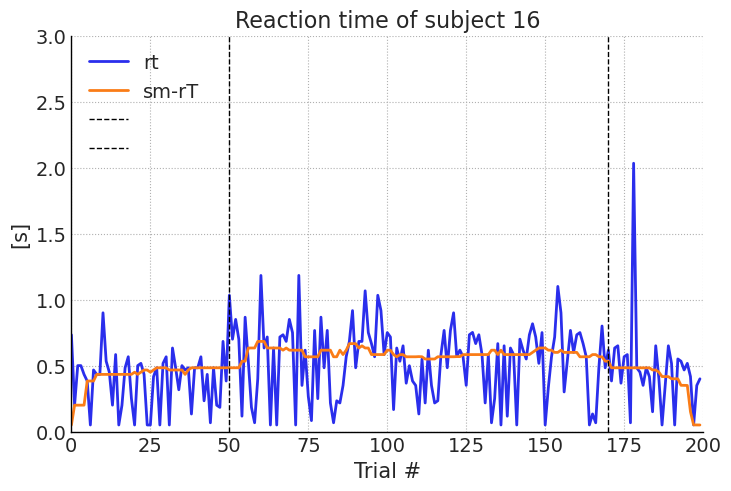

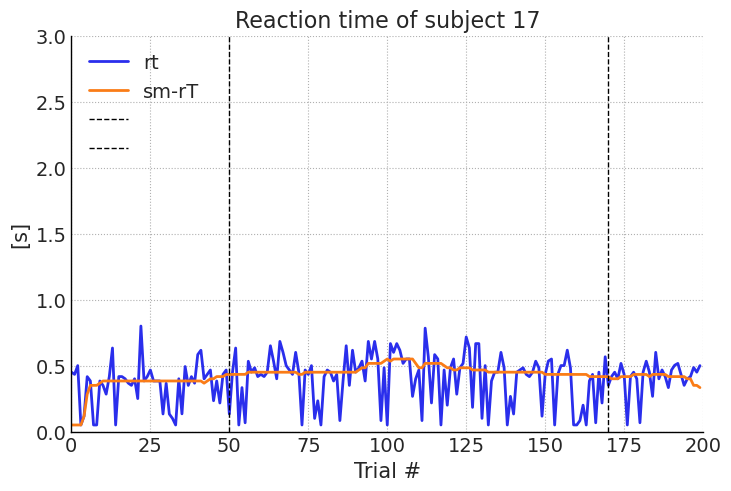

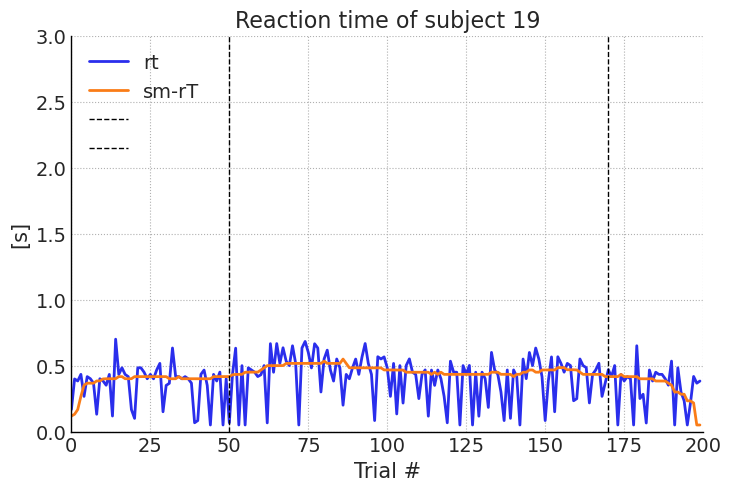

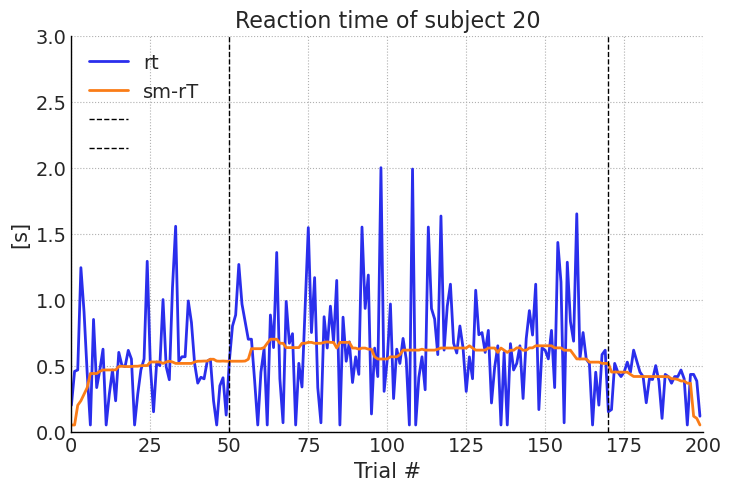

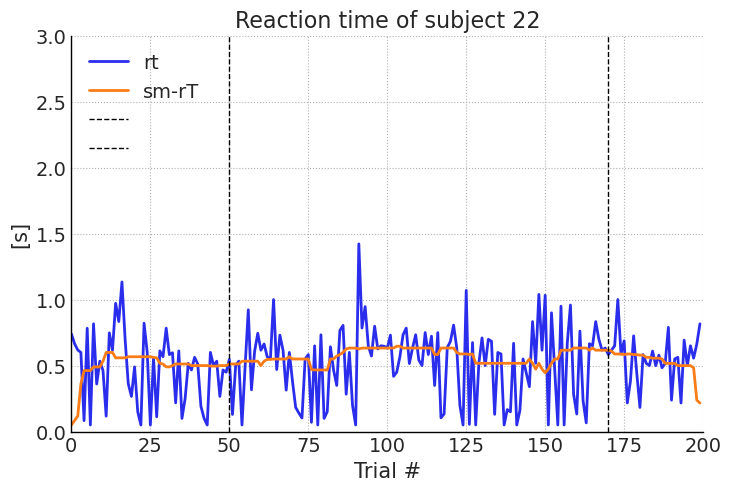

...

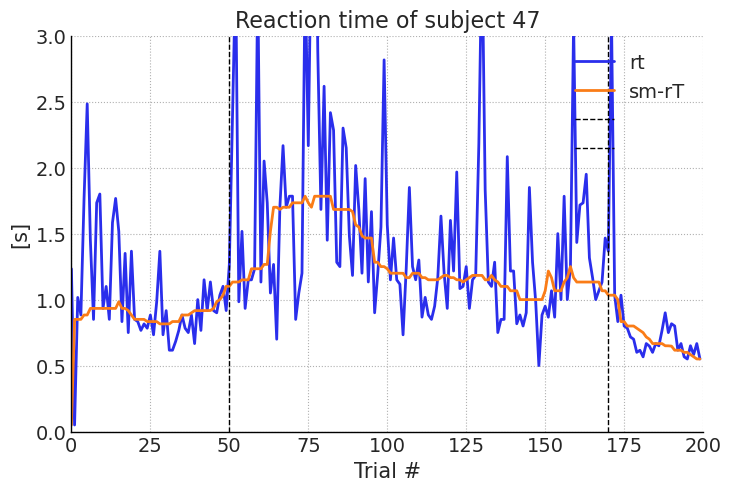

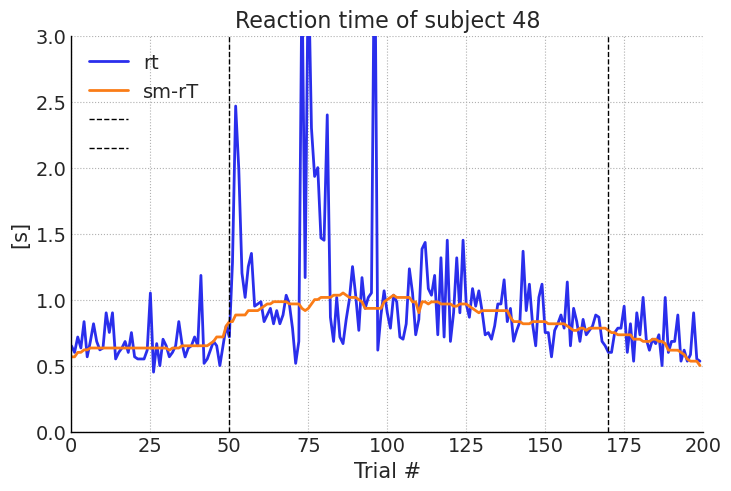

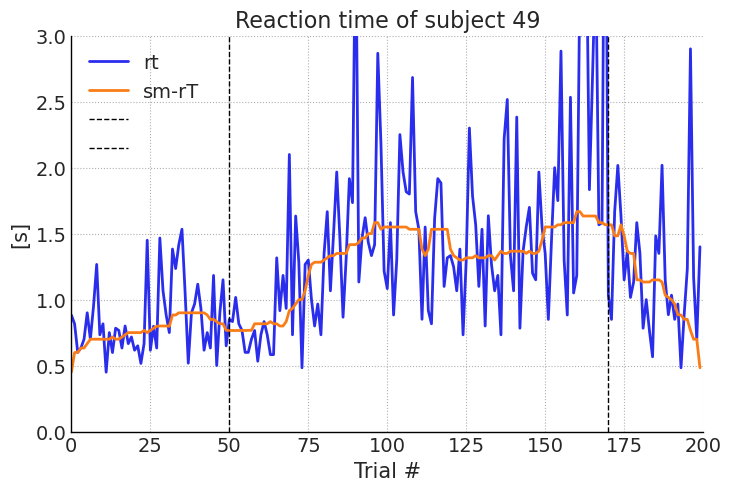

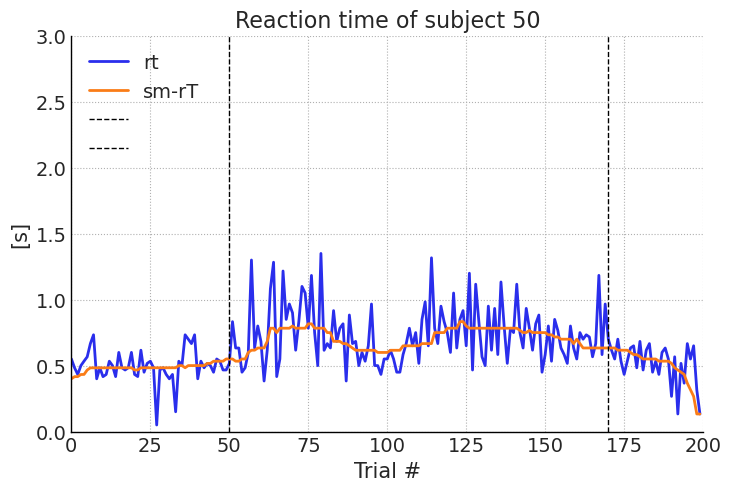

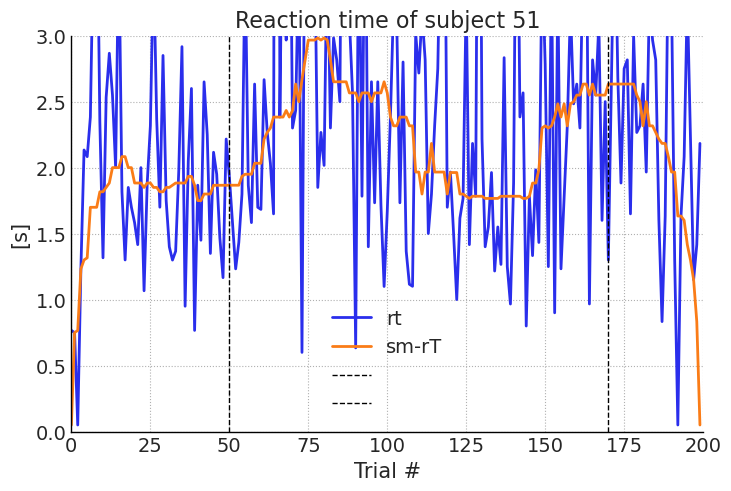

In [14]:
# Initialize lists to store RT for group 0 and group 1
RT_subj_0 = []
RT_subj_1 = []

# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():
    
    subj_data = all_data[subj_id]
    # Determine the group of the subject
    group = subj_data['hand']['group'].iloc[0]
    # Get the data for the current subject
    hand_df = subj_data['hand'] 
    RT = hand_df['RT']
    # Remove outliers and interpolate NaN values
    # convert to Pandas Series
    RT_series = pd.Series(RT)
    # clip outliers and interpolate
    RT = RT_series.clip(lower=0.05).interpolate(method='linear').values

    # smooth-median filter
    window_length = 27  # should be an odd number
    sm_RT = medfilt(RT, kernel_size=window_length)
#     sm_RT = savgol_filter(RT, window_length=7, polyorder=2)
    
    # Store data for the subject in all_data
    all_data[subj_id]['RT'] = RT
    all_data[subj_id]['sm_RT'] = sm_RT
    
    # Append the RT to the appropriate group list
    if group == 0:
        RT_subj_0.append(RT)
    elif group == 1:
        RT_subj_1.append(RT)
    # Plot
    plt.figure()
    plt.plot(RT, linewidth=2)
    plt.plot(sm_RT, linewidth=2)
    plt.ylabel('[s]')
    plt.xlabel('Trial #')
    plt.title('Reaction time of subject ' + subj_id)
    plt.ylim([0, 3])
    plt.xlim([0, 200])
    plt.plot([50, 50], [0, 3], 'k--', linewidth=1)
    plt.plot([170, 170], [0, 3], 'k--', linewidth=1)
    plt.legend(['rt', 'sm-rT', '', ''])
    plt.grid(True, linestyle=':')

#     # save
#     # Create the directory if it doesn't exist
#     output_subfolder = os.path.join(output_folder, subj_id)
#     os.makedirs(output_subfolder, exist_ok=True)
    
#     plt.savefig(os.path.join(output_folder, subj_id, subj_id + '_RT.png'))
    plt.show()

In [15]:
# # get data before fixing eye
# # subjects 16, 17, 19, 20, 22, 23, 24, 25
# if SaveAllData == 1:
    
#     # MAT file path
#     mat_file_path = 'D:/4Lab/eye_hand_8tarLppt/data/merged_data.mat'

#     # Load MATLAB file
#     mat_data = scipy.io.loadmat(mat_file_path)

#     # Extract the all_data structure
#     mat_all_data_8T = mat_data['all_data']

#     # Convert MATLAB data to Python structure and merge
#     for subj_id in mat_all_data_8T.dtype.names:
#         subj_data = mat_all_data_8T[subj_id][0, 0]
#         subj_id_str = subj_id.replace('subj_', '')  # Remove prefix to restore original numeric form

#         # Initialize the structure for each subject
#         if subj_id_str not in all_data_8T:
#             all_data_8T[subj_id_str] = {}

#         # Extract handError
#         if 'handError' in subj_data.dtype.names:
#             all_data_8T[subj_id_str]['handError'] = np.array(subj_data['handError'][0, 0]).flatten()

#         # Extract sm_handError
#         if 'sm_handError' in subj_data.dtype.names:
#             all_data_8T[subj_id_str]['sm_handError'] = np.array(subj_data['sm_handError'][0, 0]).flatten()

#         # Extract eyeError
#         if 'eyeError' in subj_data.dtype.names:
#             all_data_8T[subj_id_str]['eyeError'] = np.array(subj_data['eyeError'][0, 0]).flatten()

#         # Extract sm_eyeError
#         if 'sm_eyeError' in subj_data.dtype.names:
#             all_data_8T[subj_id_str]['sm_eyeError'] = np.array(subj_data['sm_eyeError'][0, 0]).flatten()


# create tables

In [16]:
# orgnize a new data frame for 8T experiment
# Initialize an empty list to store all data rows
data_rows = []

# Initialize the subject index
subject_index = 1

# Iterate over all subjects
for subject_id, subject_data in all_data.items():
    hand_error = subject_data['handError']
    eye_error = subject_data['eyeError']
    group = subject_data['hand']['group'][1]
    RT = subject_data['hand']['RT'].values
    # Determine the number of trials for each subject
    num_trials = len(hand_error)
    
    # Iterate over each trial
    for trial_num in range(1, num_trials + 1):
        if trial_num <= 25:
            ep_index = 0
        elif trial_num <= 50:
            ep_index = 1
        elif trial_num <= 170:
            ep_index = 2 + (trial_num - 51)
        elif trial_num <= 178:
            ep_index = 122
        else:
            ep_index = 123
        
        # Construct the data for each row
        row = {
            'handError': hand_error[trial_num - 1],
            'eyeError': eye_error[trial_num - 1],
            'subject': subject_index,
            'sIndex': subject_index - 1,
            'trialNum': trial_num,
            'epIndex': ep_index,
            'gp': group,
            'delay':group+1,
            'reactionTime':RT[trial_num - 1]
        }
        
        # Append this row of data to the list
        data_rows.append(row)
    
    # Increment the subject index
    subject_index += 1

# Convert all rows of data into a DataFrame
allTable = pd.DataFrame(data_rows)

In [17]:
allTable

,handError,eyeError,subject,sIndex,trialNum,epIndex,gp,delay,reactionTime
0,7.257475,3.998190,1,0,1,0,1.0,2.0,0.733450
1,-8.484714,-5.229100,1,0,2,0,1.0,2.0,0.200077
2,-16.021805,-6.782130,1,0,3,0,1.0,2.0,0.499910
3,4.515809,-6.444483,1,0,4,0,1.0,2.0,0.499996
4,6.433834,-5.178641,1,0,5,0,1.0,2.0,0.433197
...,...,...,...,...,...,...,...,...,...
6195,9.441923,-11.818482,31,30,196,123,0.0,1.0,3.299793
6196,2.400899,4.612151,31,30,197,123,0.0,1.0,2.216457
6197,6.754553,-23.152823,31,30,198,123,0.0,1.0,1.150230
6198,-4.771857,-21.984082,31,30,199,123,0.0,1.0,1.416505


In [18]:
# Select data with trialNum between 51 and 170
adapt_data = allTable[(allTable['trialNum'] >= 51) & (allTable['trialNum'] <= 170)]
aftereffect_data = allTable[(allTable['trialNum'] >= 171) & (allTable['trialNum'] <= 200)]

# Count the number of times handError is greater than -12° (60% adaptation) for each subject
subject_notLearn_counts = adapt_data[adapt_data['handError'] > -12].groupby('subject').size()
subject_badAE_means = aftereffect_data.groupby('subject')['handError'].mean()

# Identify bad subjects, i.e., subjects with more than half of the trials having handError greater than -12°
bad_subjects_notLearn = subject_notLearn_counts[subject_notLearn_counts > 80].index.tolist()

# Identify bad subjects with the mean of handError less than -35°
bad_subjects_AE = subject_badAE_means[subject_badAE_means < -35].index.tolist()

# Output the IDs of bad subjects
print('Not-learn subjects: ', bad_subjects_notLearn)
print('Bad aftereffect subjects: ', bad_subjects_AE)


Not-learn subjects:  []
Bad aftereffect subjects:  []


In [19]:
subject_notLearn_counts

subject
1     18
2     37
3     19
4     21
5     12
6     21
7      7
8     34
9      9
10    20
11    49
12    18
13    13
14    66
15    34
16    17
17     9
18    58
19     8
20    23
21     8
22    14
23    23
24    27
25    27
26    42
27    39
28    20
29    37
30    22
31    29
dtype: int64

In [20]:
# Define the allEpisodes array
allEpisodes = np.concatenate((
    np.array([1, 2], dtype=np.int64),       # early-baseline and late-baseline
    np.arange(100, 220, dtype=np.int64),   # adaptation
    np.array([300], dtype=np.int64)        # aftereffect
))

In [21]:
# get episodeTable
episodeTable = allTable[['trialNum', 'gp', 'epIndex']].drop_duplicates().reset_index(drop=True)
episodeTable['groupIDEp'] = (episodeTable['gp'].astype(int) + 1).astype(int)

episodeTable['episode'] = np.where(
    episodeTable['trialNum'] <= 25, 1,
    np.where(
        episodeTable['trialNum'] <= 50, 2,
        np.where(
            episodeTable['trialNum'] <= 170, 100 + (episodeTable['trialNum'] - 51),
            np.where(
                episodeTable['trialNum'] <= 178, 300,
            400
            )
        )
    )
)
episodeTable.rename(columns={'trialNum': 'trialNumEp'}, inplace=True)
episodeTable.drop(columns=['gp'], inplace=True)

episodeTable['groupIDEp'] = episodeTable['groupIDEp'].replace({1: 2, 2: 1})

# plot

## plot hand

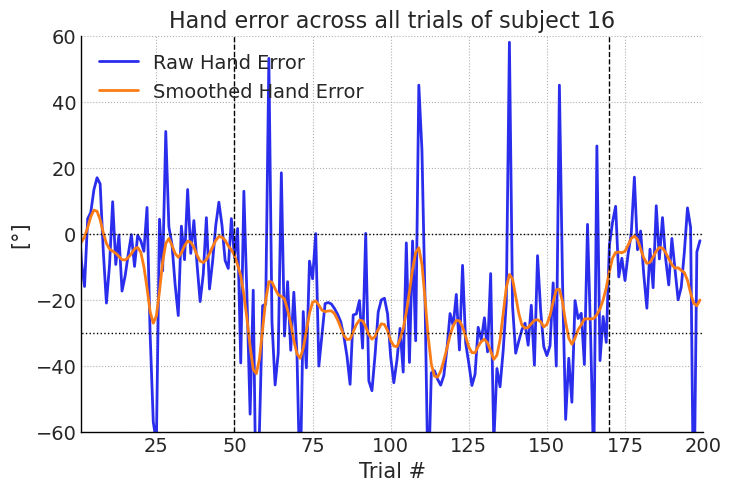

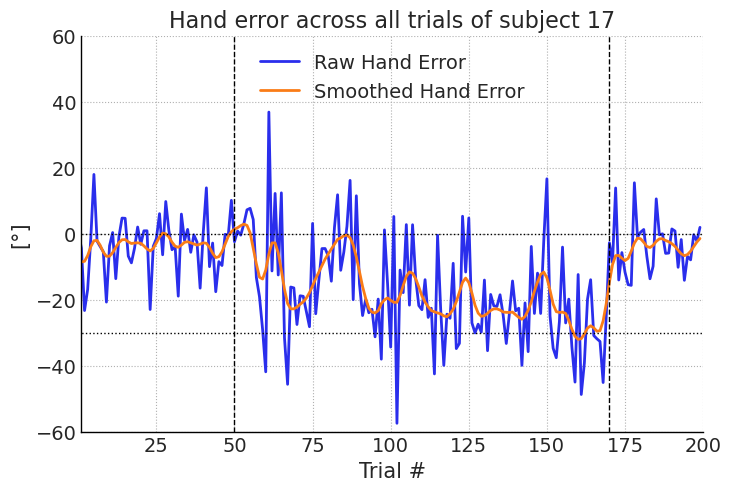

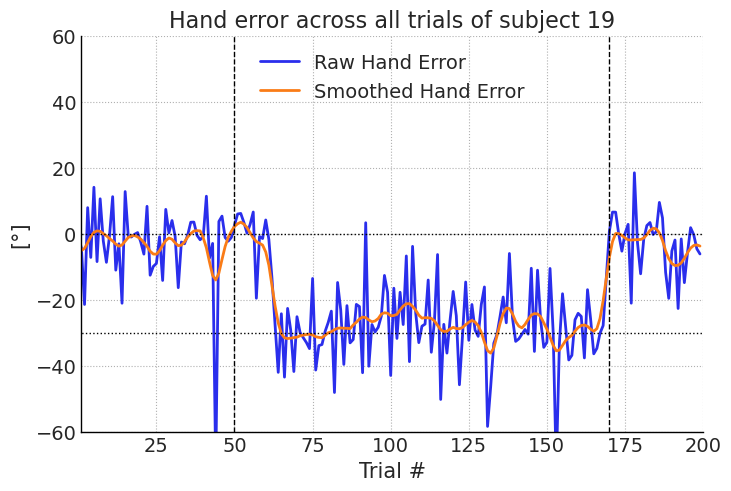

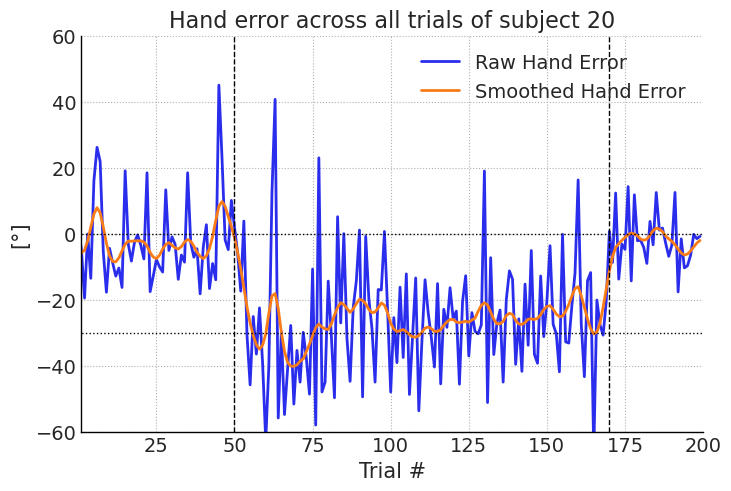

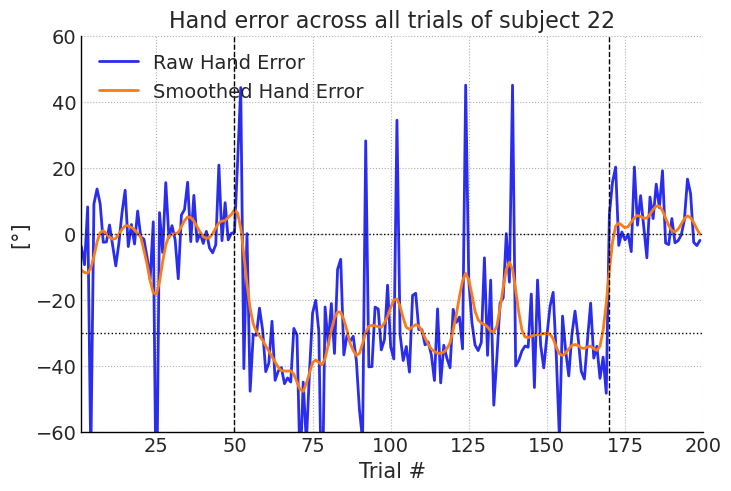

...

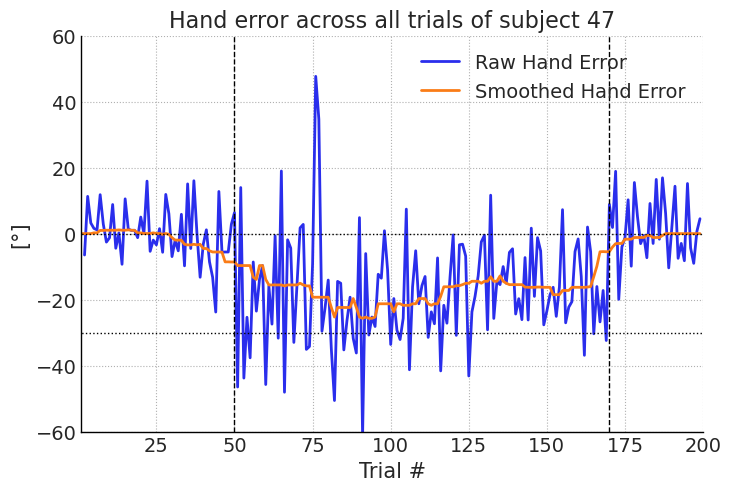

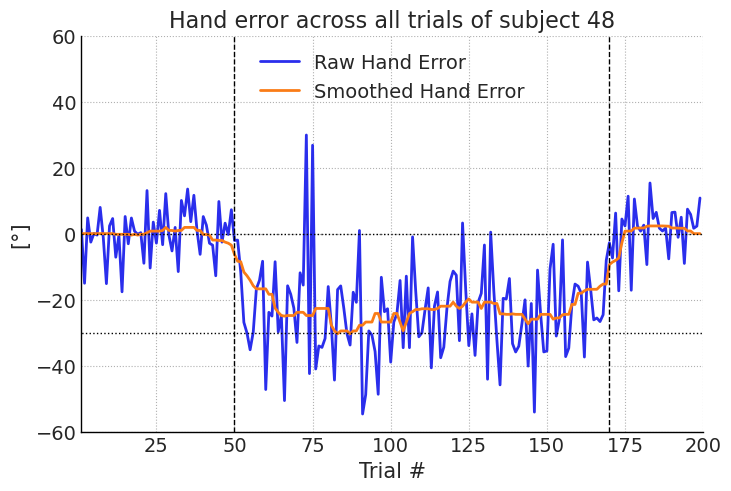

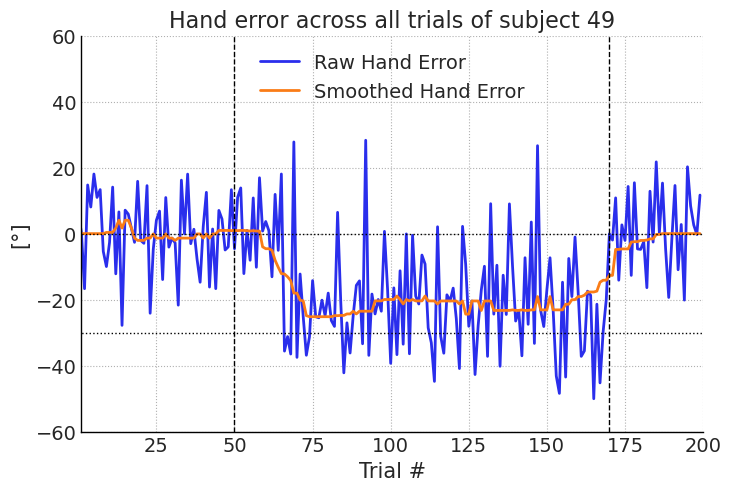

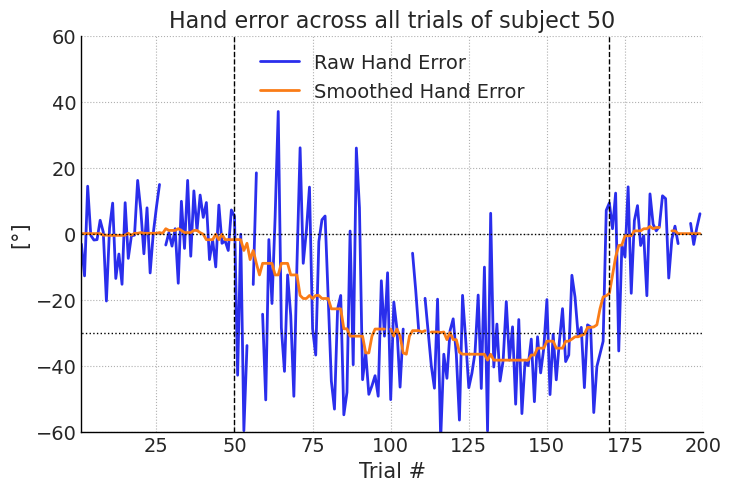

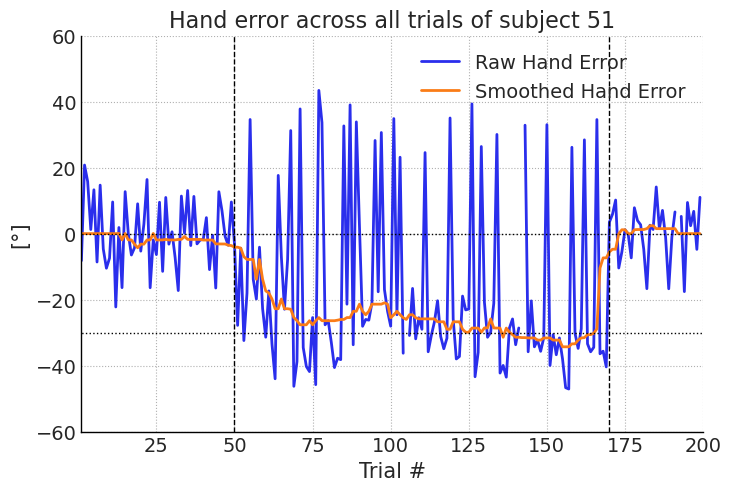

In [22]:
# Plot raw and smoothed hand error
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():
    handError = all_data[subj_id]['handError']
    sm_handError = all_data[subj_id]['sm_handError']
    
    plt.figure()
    Herr_raw, = plt.plot(handError, linewidth=2, label='Raw Hand Error')
    Herr_smooth, = plt.plot(sm_handError, linewidth=2, label='Smoothed Hand Error')
    plt.ylabel('[°]')
    plt.xlabel('Trial #')
    plt.title('Hand error across all trials of subject ' + subj_id)
    plt.ylim([-60, 60])
    plt.xlim([1, 200])
    plt.plot([50, 50], [-60, 60], 'k--', linewidth=1)
    plt.plot([170, 170], [-60, 60], 'k--', linewidth=1)
    plt.plot([0, 200], [0, 0], 'k:', linewidth=1)
    plt.plot([0, 200], [-30, -30], 'k:', linewidth=1)
    plt.legend(['Raw Hand Error', 'Smoothed Hand Error'])
    plt.grid(True, linestyle=':')
#     # save
#     plt.savefig(os.path.join(output_folder, subj_id, subj_id + '_HandErr.png'))
    plt.show()

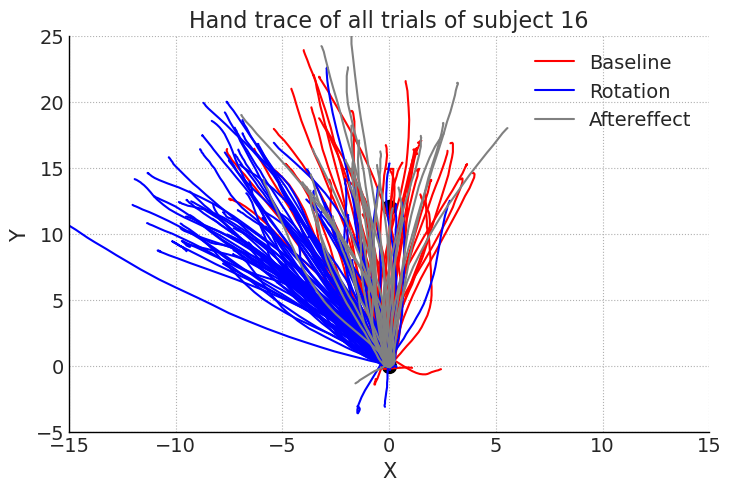

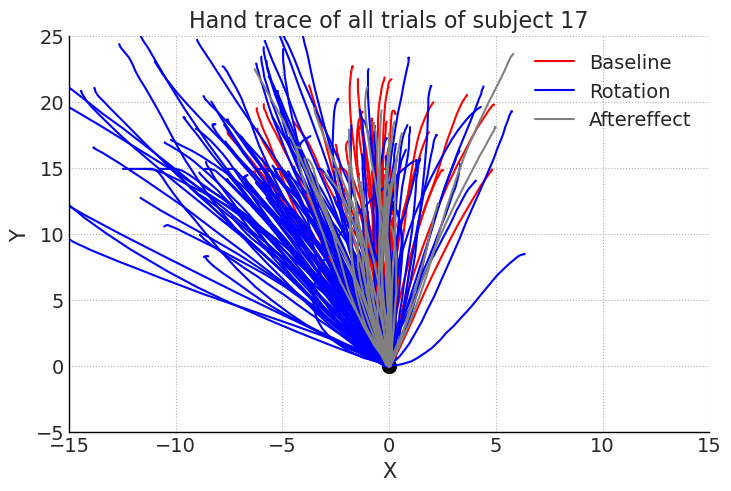

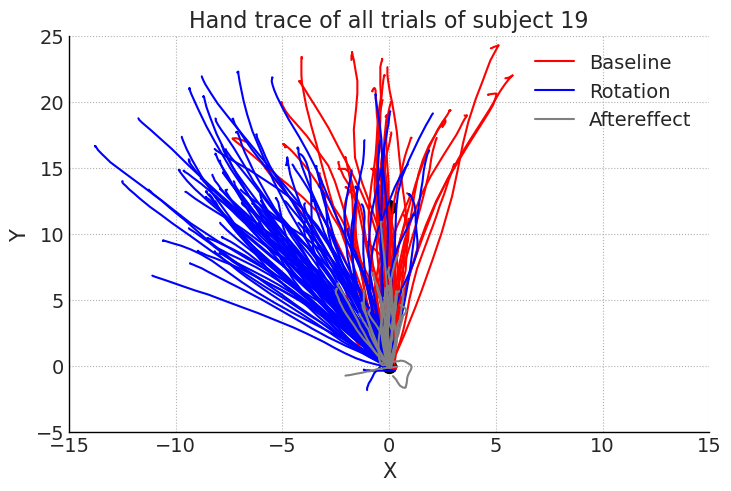

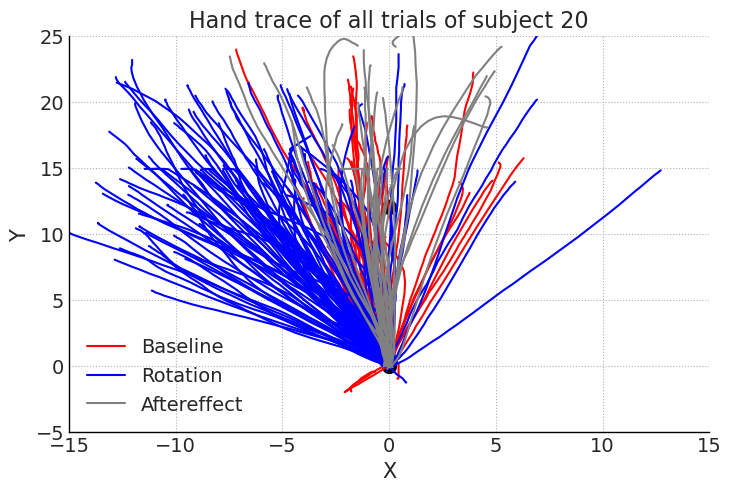

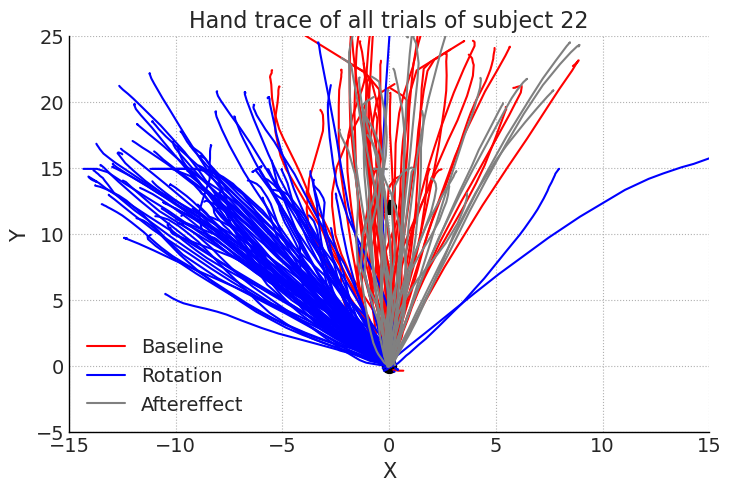

...

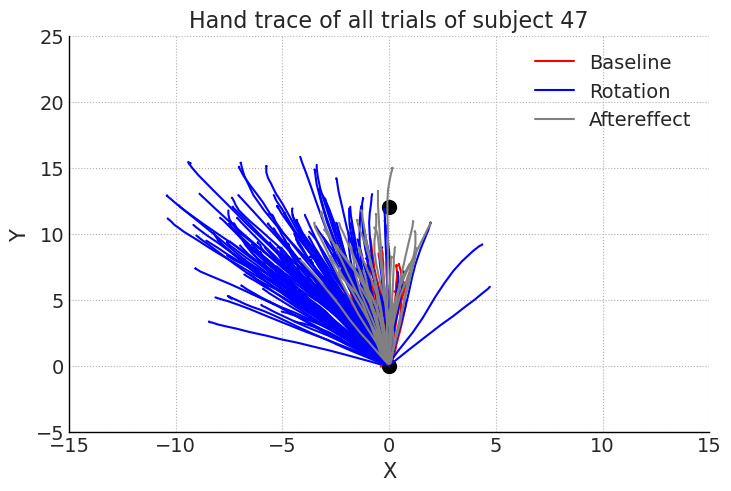

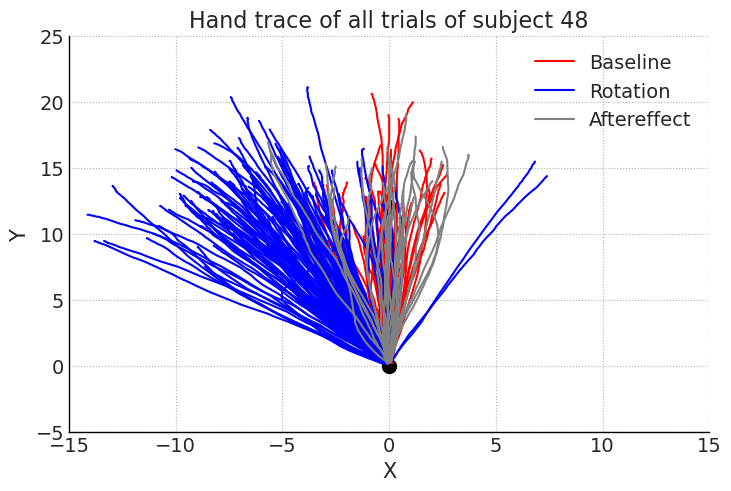

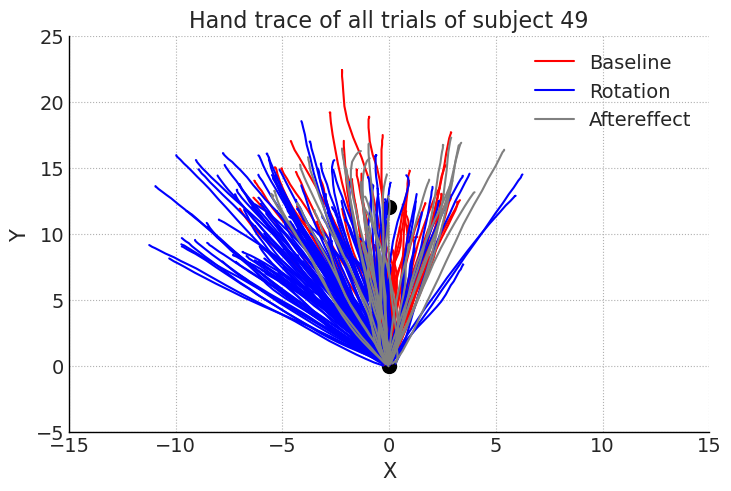

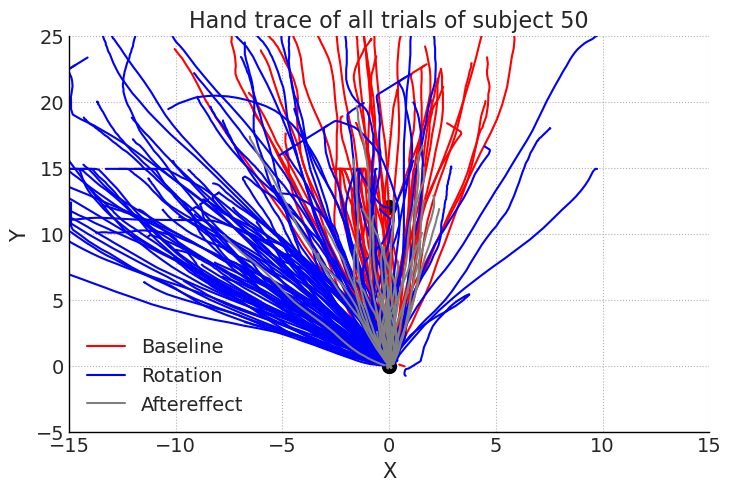

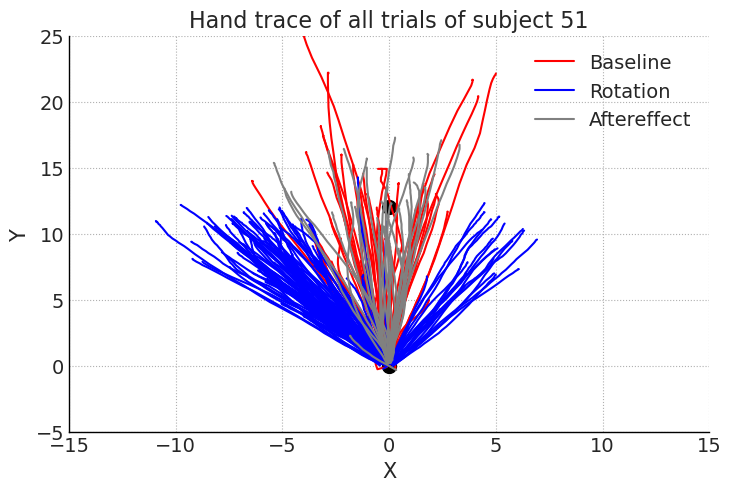

In [23]:
# Plot hand trace of all trials
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():
    rotated_hand = all_data[subj_id]['rotated_hand']
    hand_df = all_data[subj_id]['hand']  
    
    rotated_hand_array = [np.array(trial) for trial in rotated_hand]

    plt.figure()
    baseline_legend_added = False
    rotation_legend_added = False
    aftereffect_legend_added = False

    # Loop to draw the rotated hand trajectory for each trial
    for i in range(len(rotated_hand)):
        if hand_df['baseline'][i] == 1:
            if not baseline_legend_added:
                baseline_hand, = plt.plot(rotated_hand_array[i][:, 0], rotated_hand_array[i][:, 1], '-', color='r')
                baseline_legend_added = True
            else:
                plt.plot(rotated_hand_array[i][:, 0], rotated_hand_array[i][:, 1], '-', color='r')
        elif hand_df['rotation'][i] == 1:
            if not rotation_legend_added:
                rotation_hand, = plt.plot(rotated_hand_array[i][:, 0], rotated_hand_array[i][:, 1], '-', color='b')
                rotation_legend_added = True
            else:
                plt.plot(rotated_hand_array[i][:, 0], rotated_hand_array[i][:, 1], '-', color='b')
        elif hand_df['aftereffect'][i] == 1:
            if not aftereffect_legend_added:
                aftereffect_hand, = plt.plot(rotated_hand_array[i][:, 0], rotated_hand_array[i][:, 1], '-', color='grey')
                aftereffect_legend_added = True
            else:
                plt.plot(rotated_hand_array[i][:, 0], rotated_hand_array[i][:, 1], '-', color='grey')

    # scatter the origin and target
    plt.scatter([0, 0], [12, 0], s=100, c='k', marker='o', zorder=2)

    plt.xlabel('X')
    plt.ylabel('Y')
    plt.title('Hand trace of all trials of subject ' + subj_id)
    plt.legend(handles=[baseline_hand, rotation_hand, aftereffect_hand], labels=['Baseline', 'Rotation', 'Aftereffect'])
    plt.axis([-15, 15, -5, 25])
    plt.grid(True, linestyle=':')

#     # save
#     plt.savefig(os.path.join(output_folder, subj_id, subj_id + '_allHandTrace.png'))
    plt.show()

## plot eye

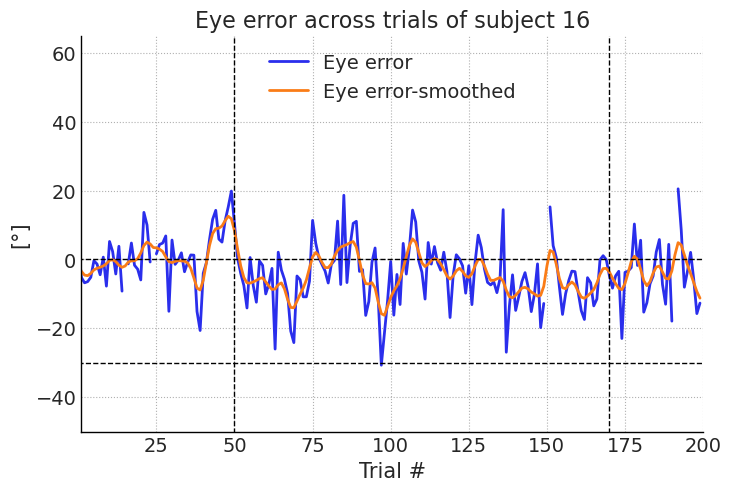

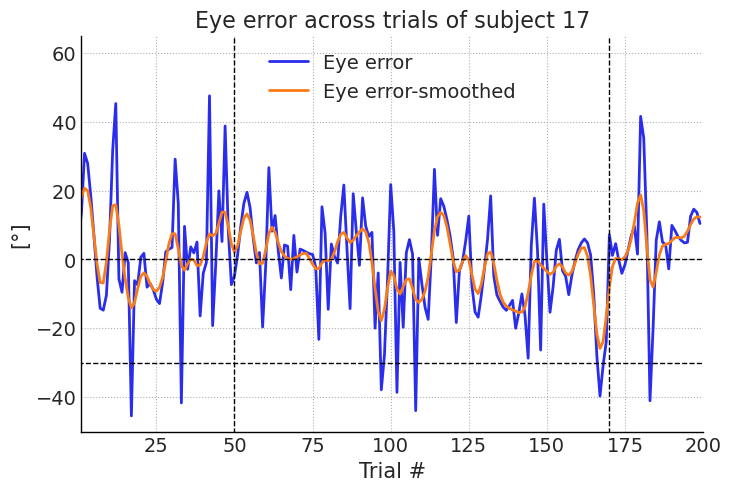

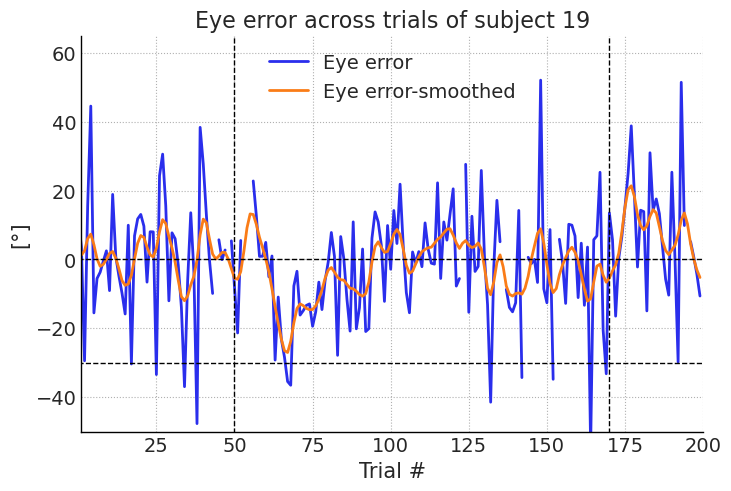

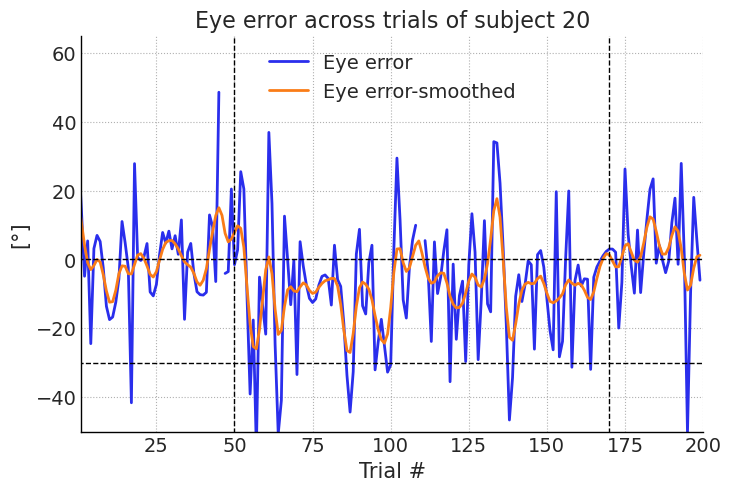

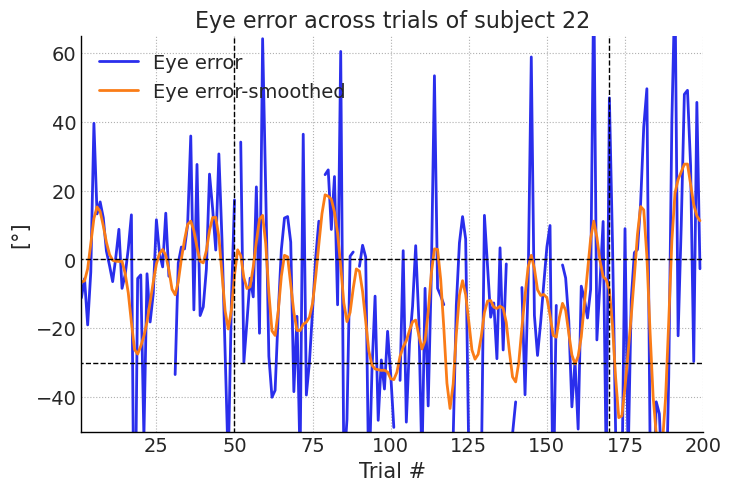

...

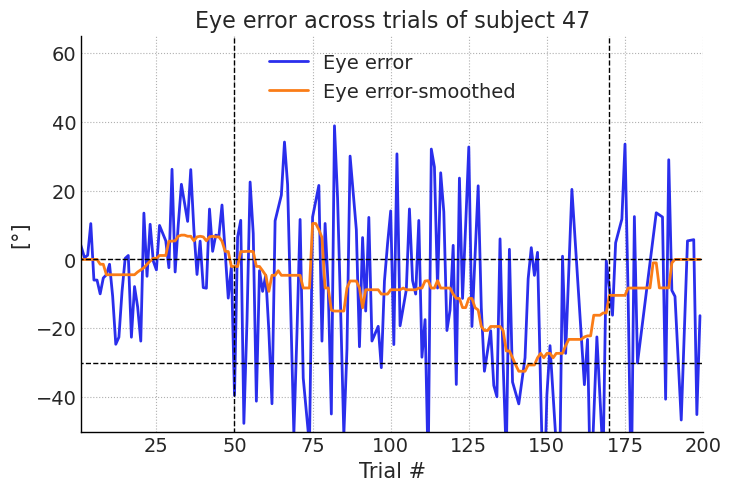

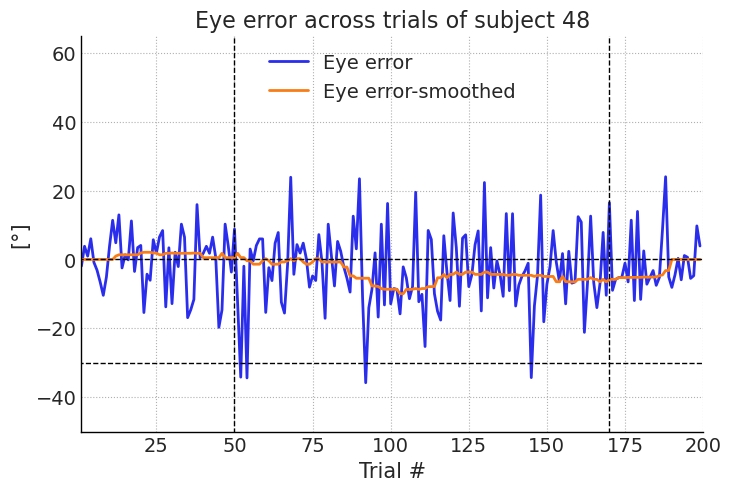

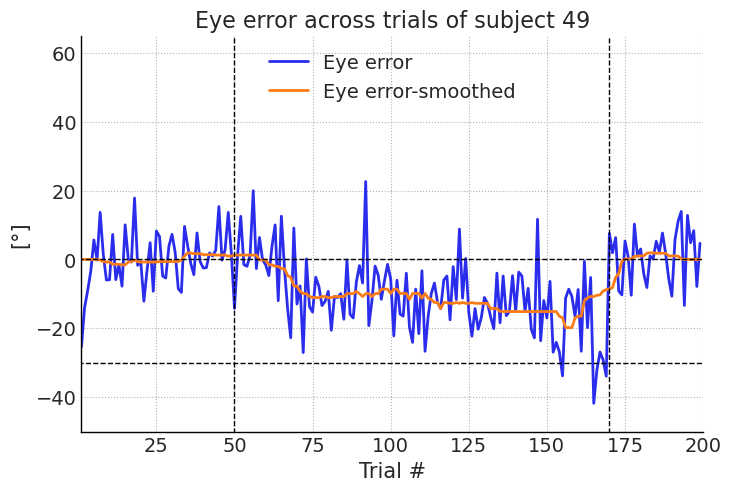

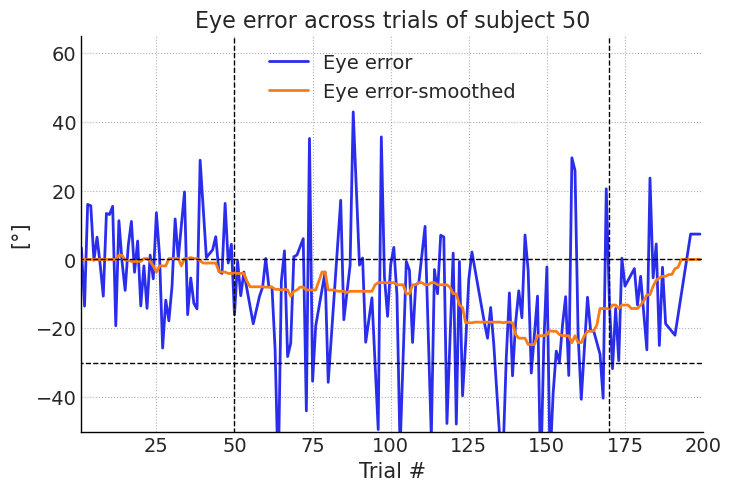

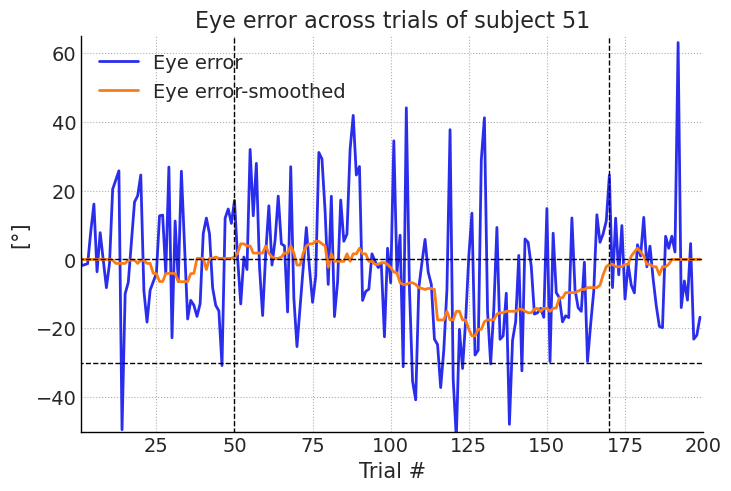

In [24]:
# plot eye error
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():    
    eyeError = all_data[subj_id]['eyeError'] 
    sm_eyeError = all_data[subj_id]['sm_eyeError']
    
    plt.figure()
    plt.plot(eyeError, linewidth=2)
    plt.plot(sm_eyeError, linewidth=2)
    plt.ylabel('[°]')
    plt.xlabel('Trial #')
    plt.title('Eye error across trials of subject '+ subj_id)
    plt.ylim(-50, 65)
    plt.xlim(1, num_trials)
    plt.plot([50, 50], [-200, 200], 'k--', linewidth=1)
    plt.plot([170, 170], [-200, 200], 'k--', linewidth=1)
    plt.plot([0, 200], [0, 0], 'k--', linewidth=1)
    plt.plot([0, 200], [-30, -30], 'k--', linewidth=1)
    plt.legend(['Eye error', 'Eye error-smoothed'])
    plt.grid(True, linestyle=':')

#     # save
#     plt.savefig(os.path.join(output_folder, subj_id, subj_id + '_EyeError.png'))
    plt.show()

## plot hand and eye trace together

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


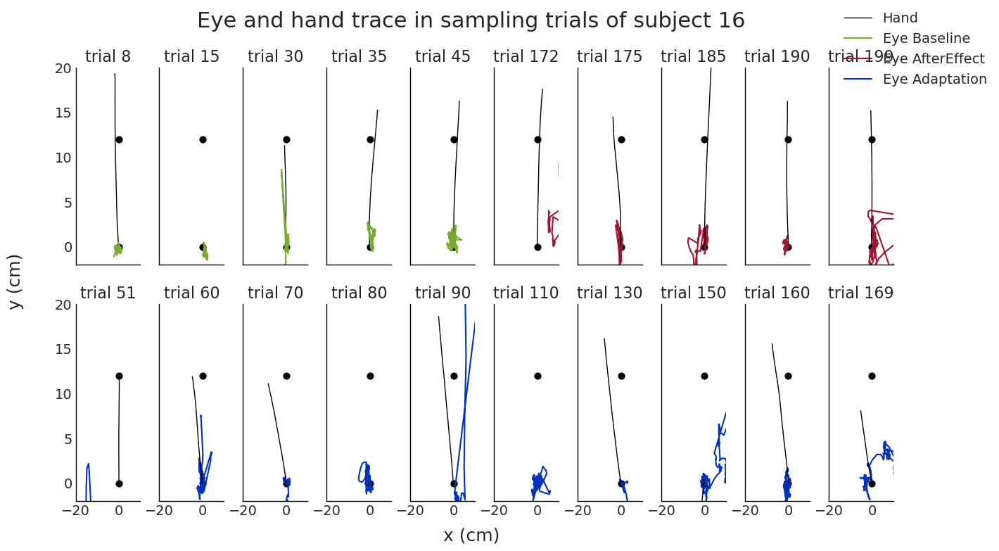

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


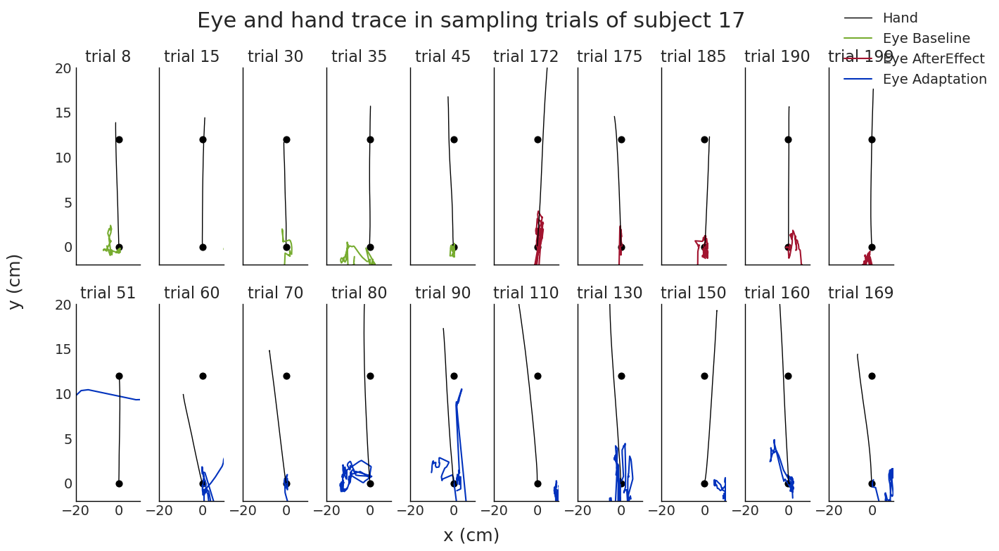

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


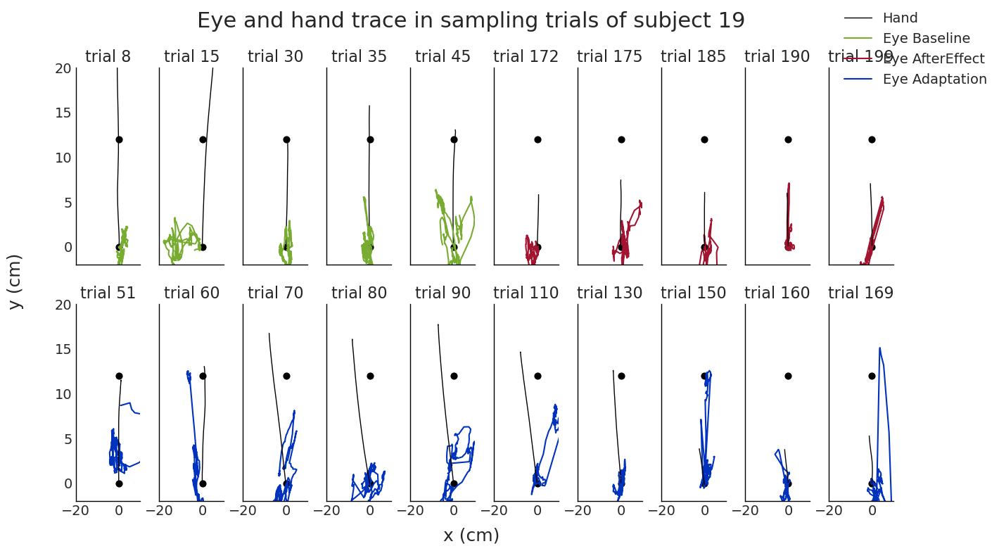

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


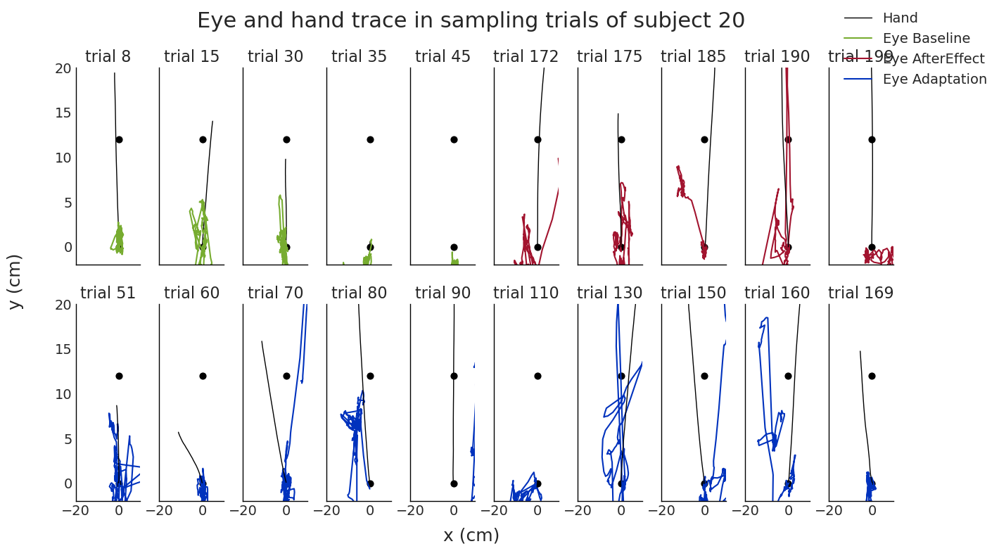

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


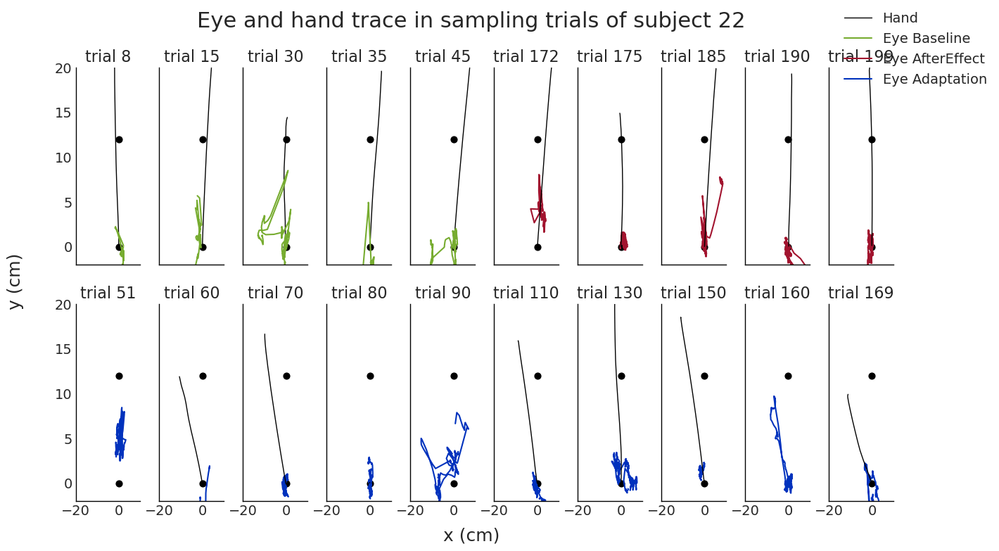

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


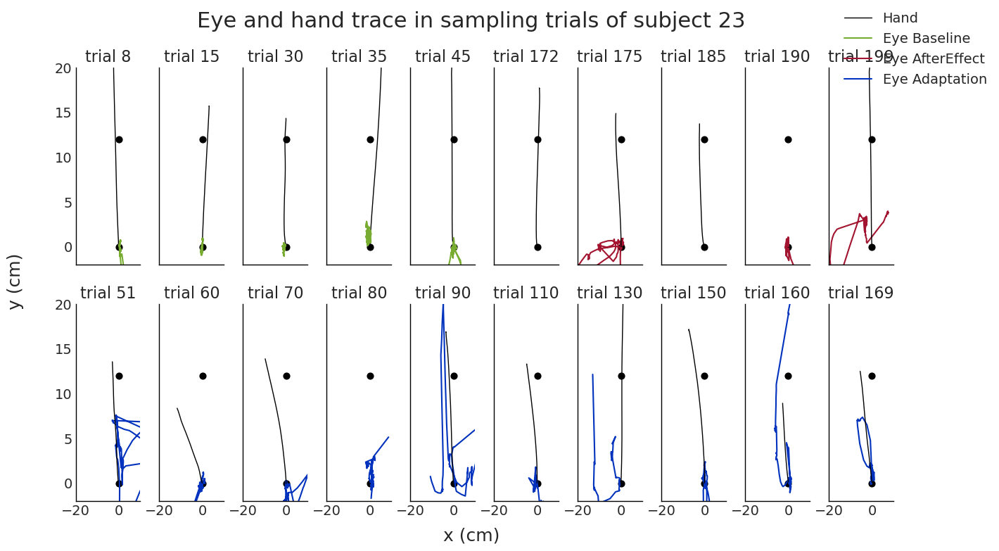

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


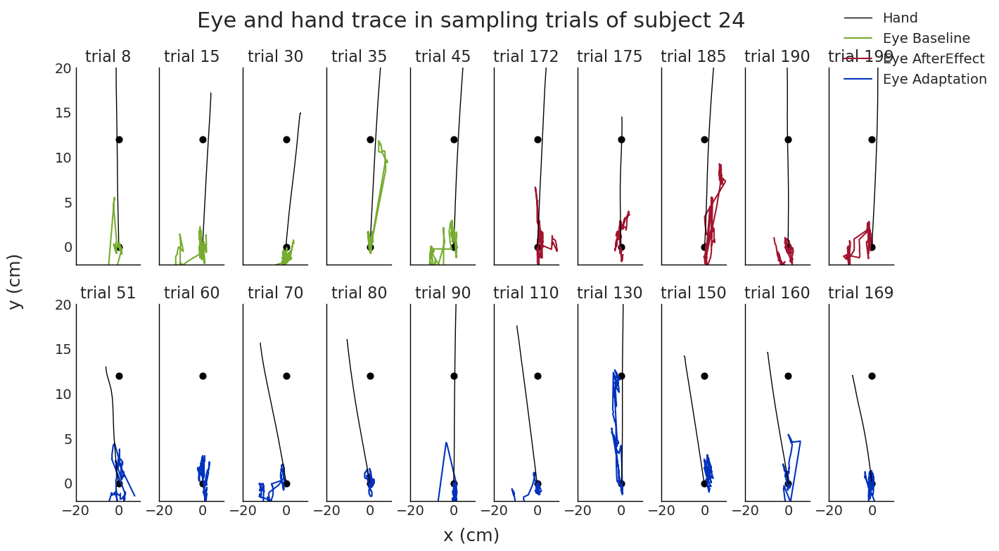

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


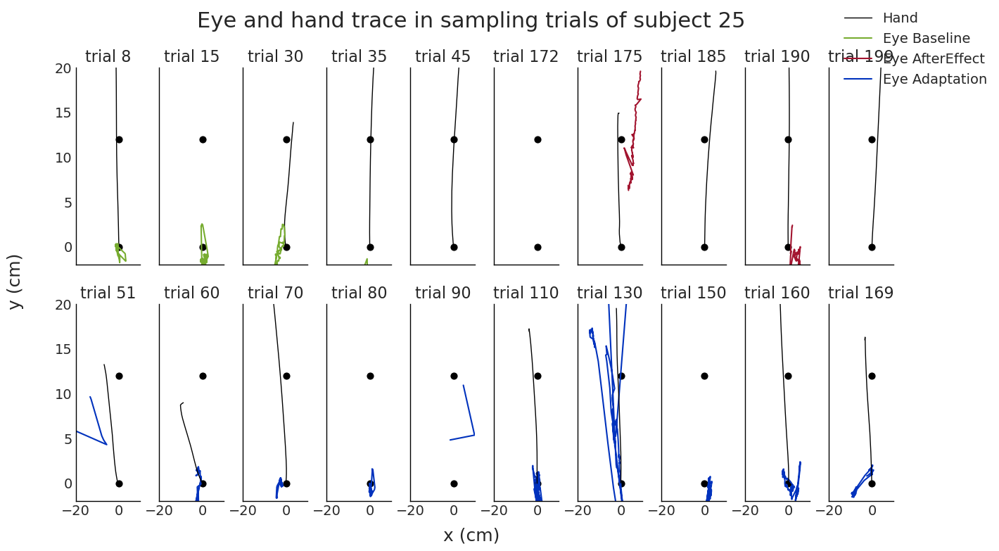

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


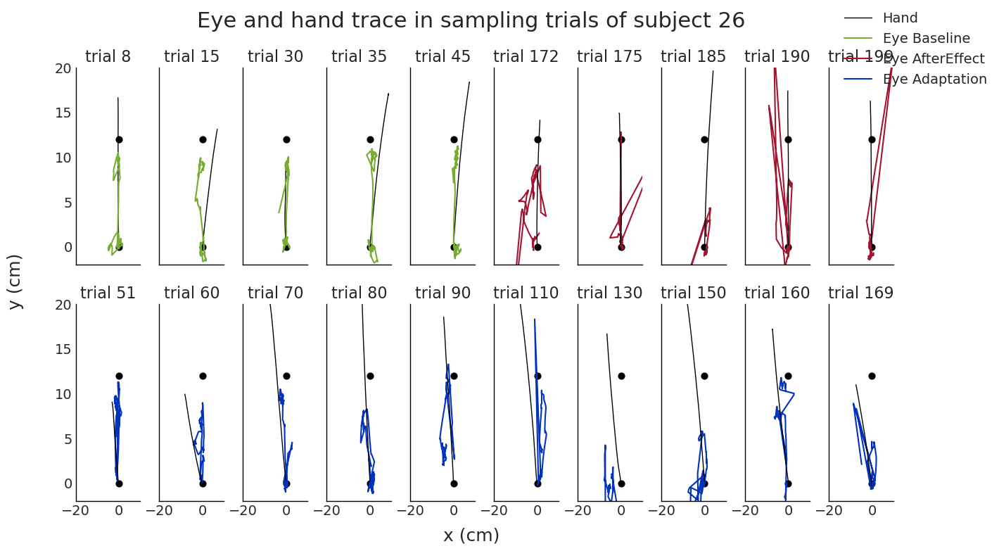

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


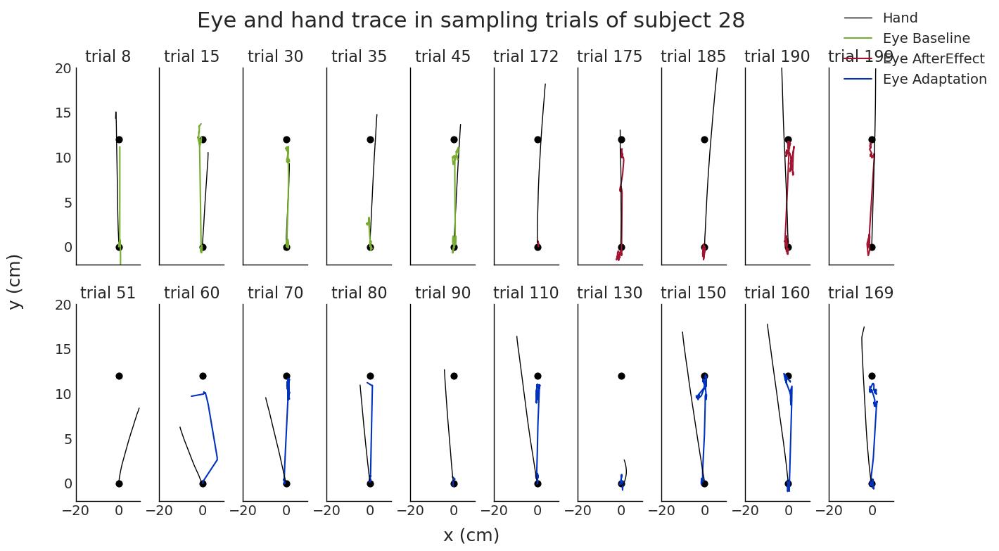

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


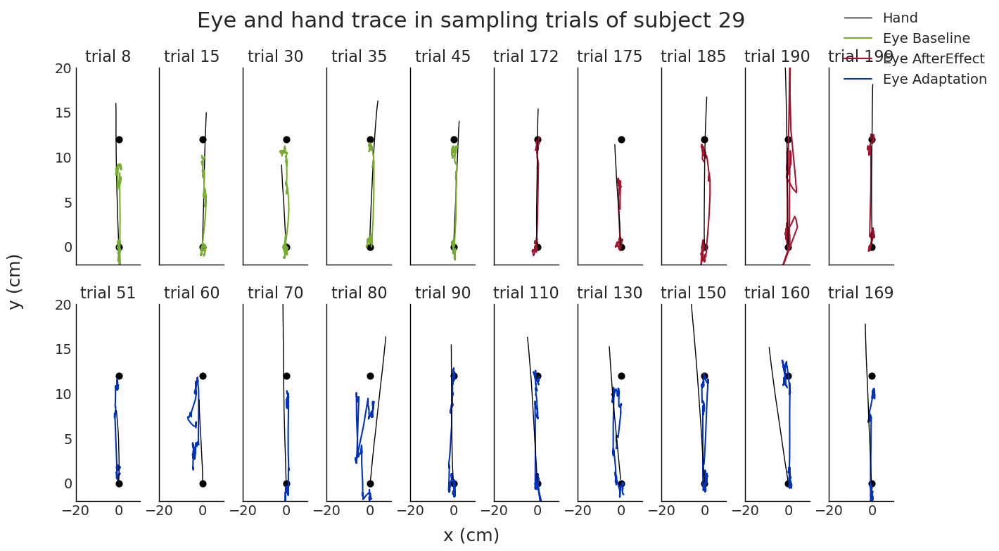

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


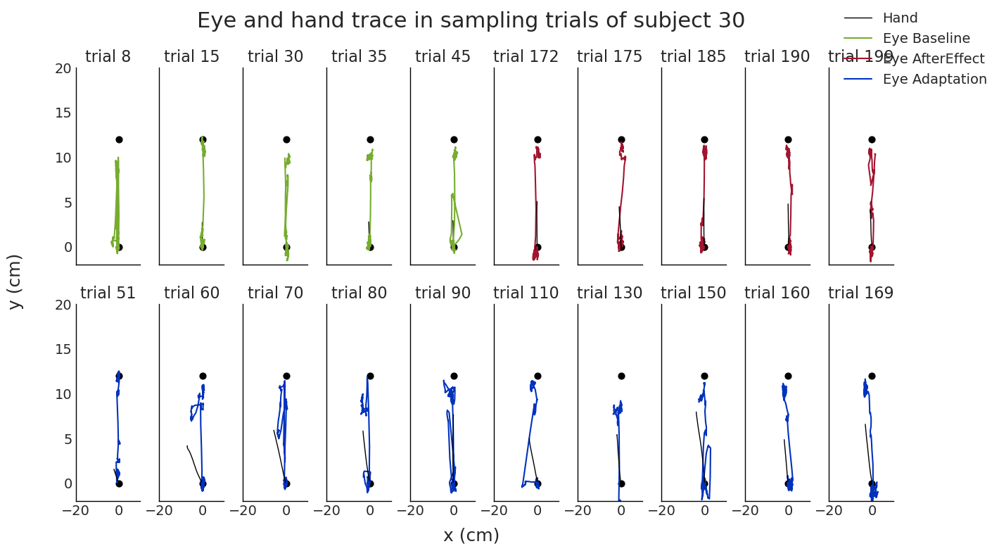

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


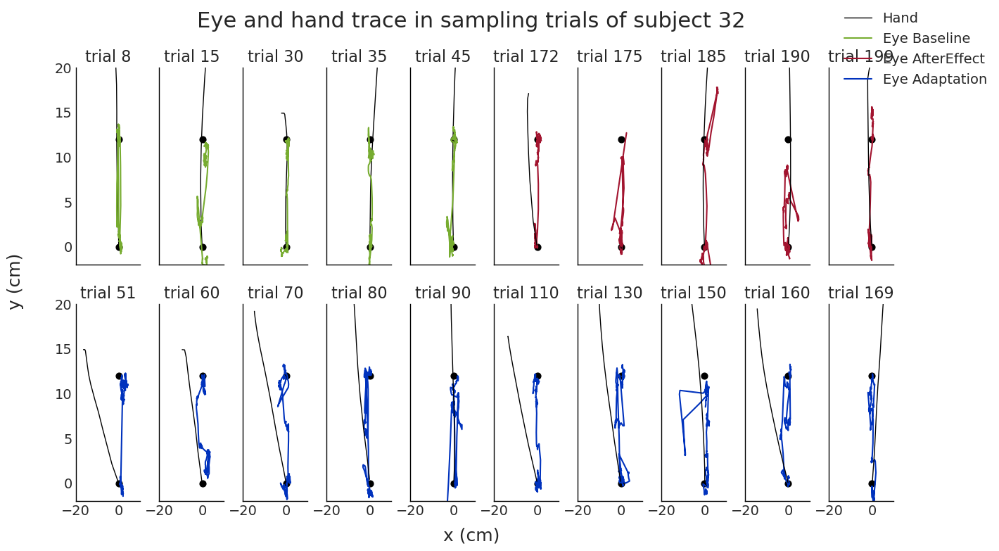

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


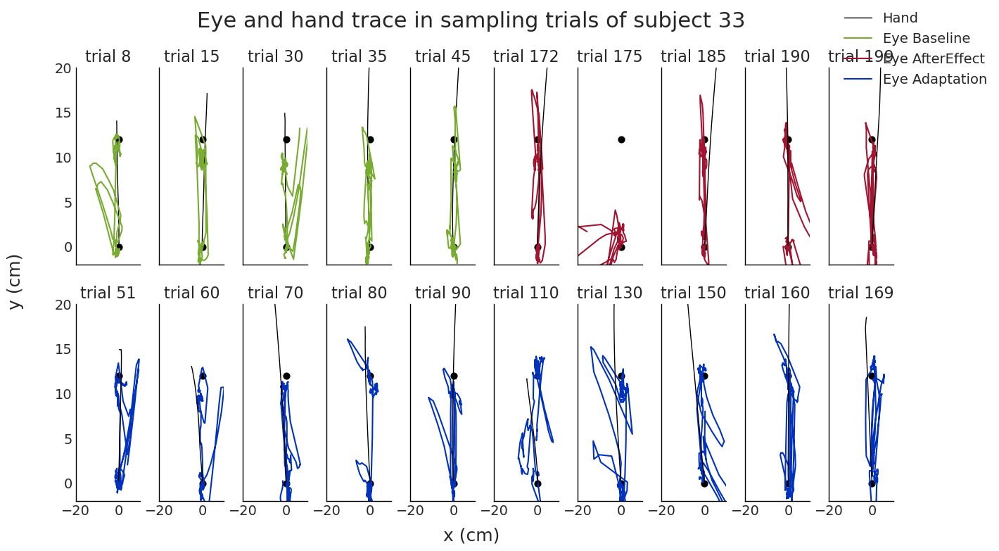

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


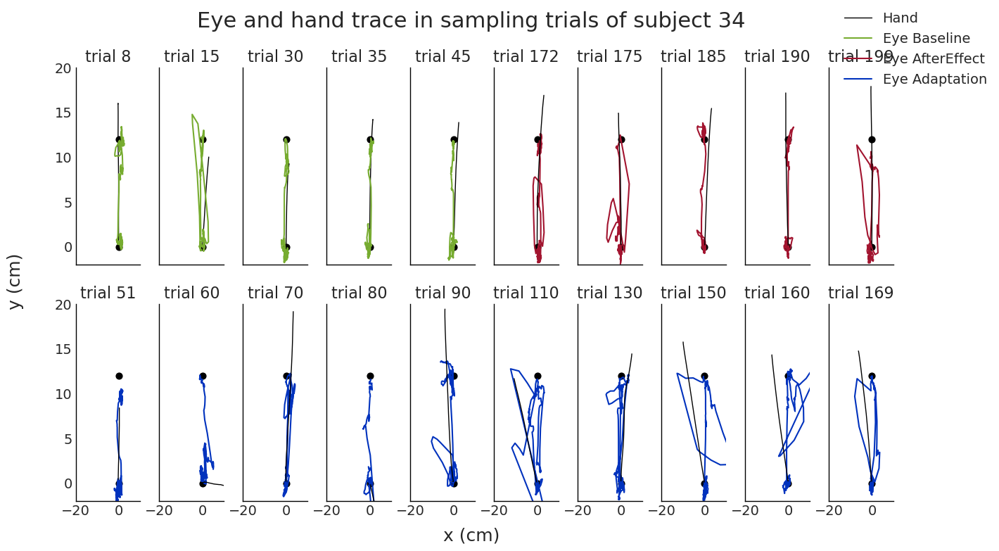

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


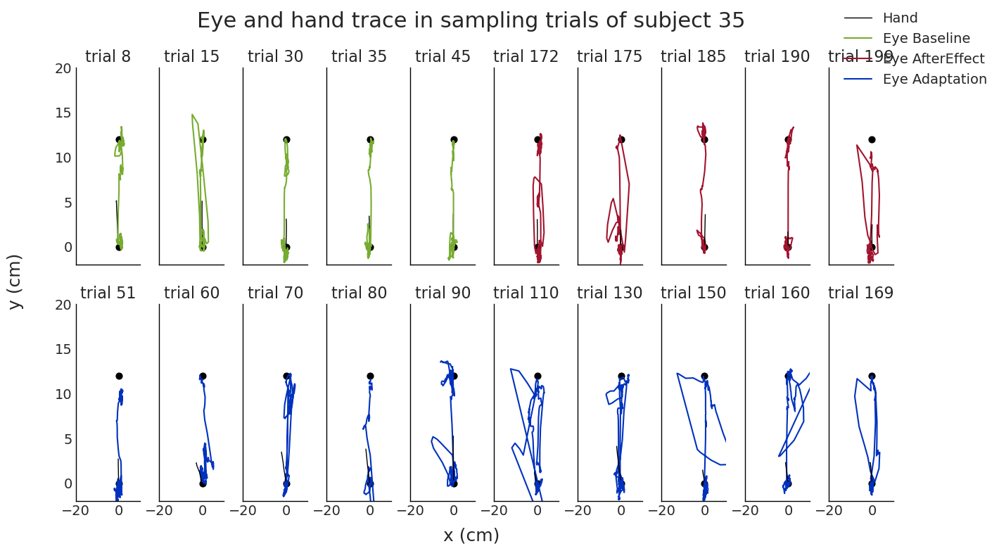

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


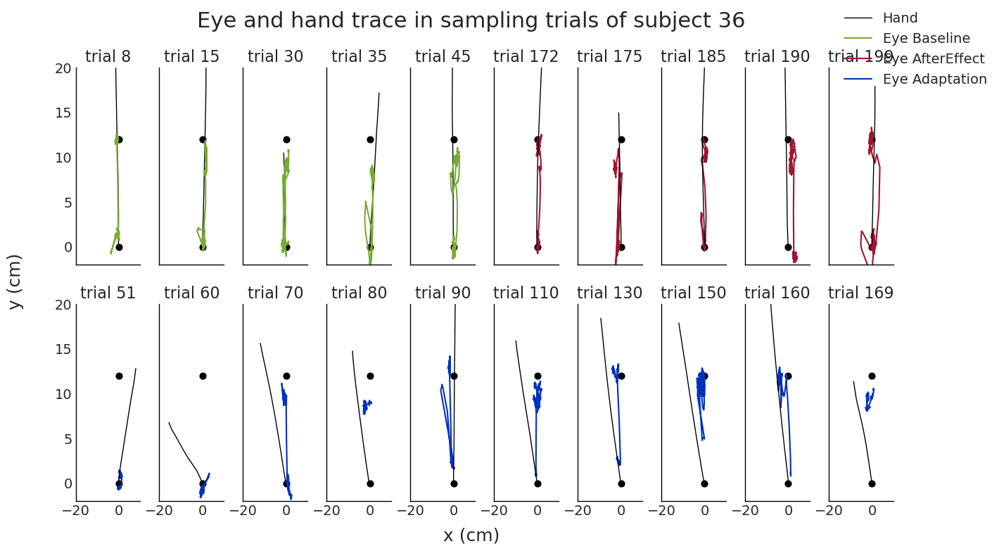

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


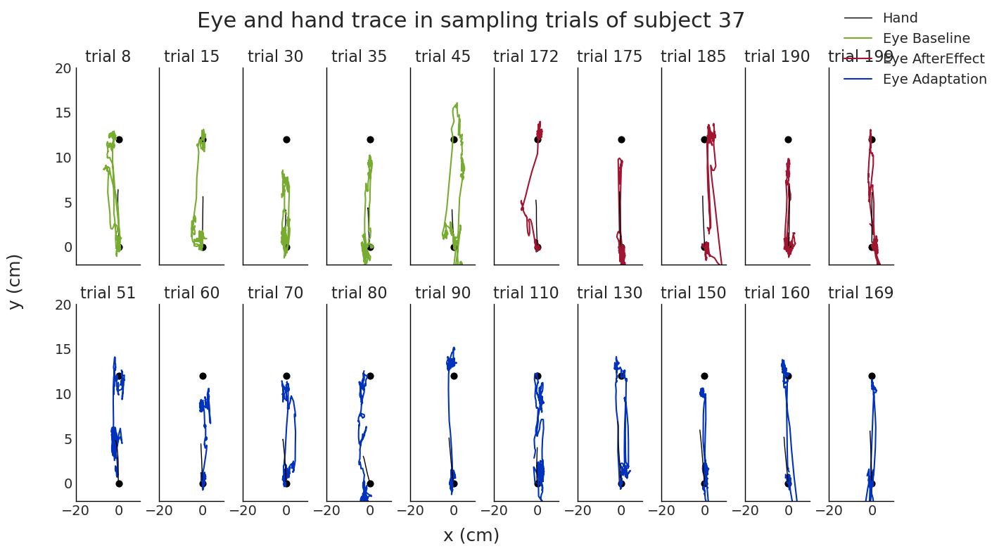

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


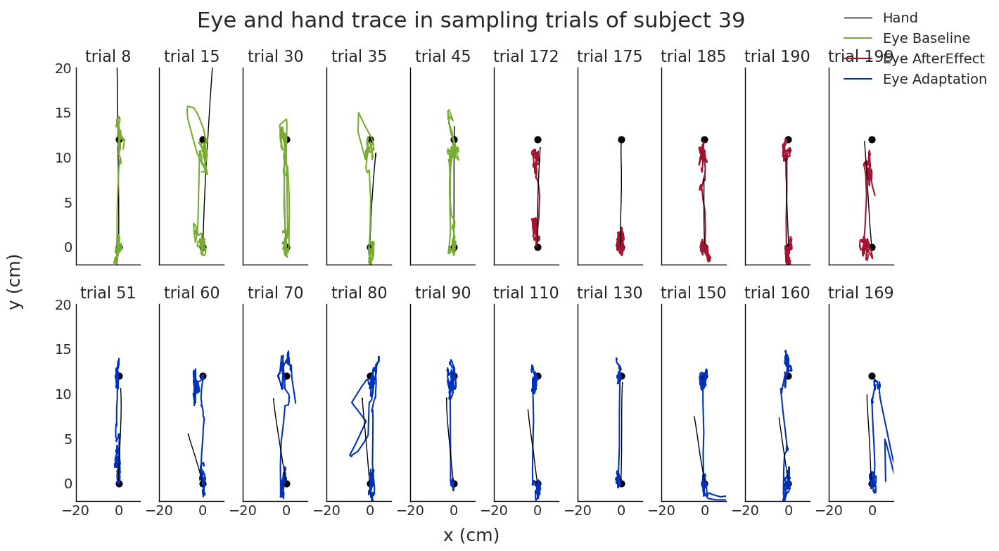

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


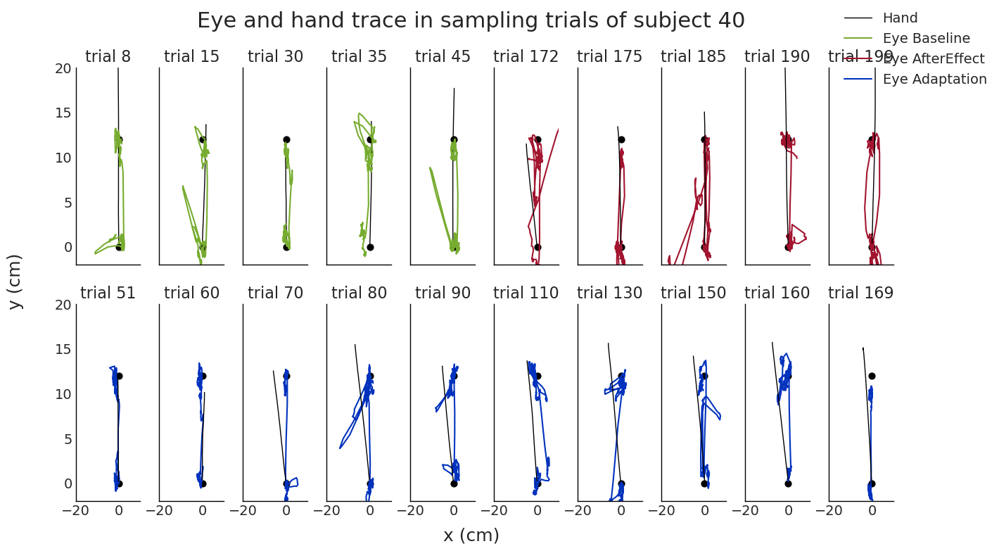

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


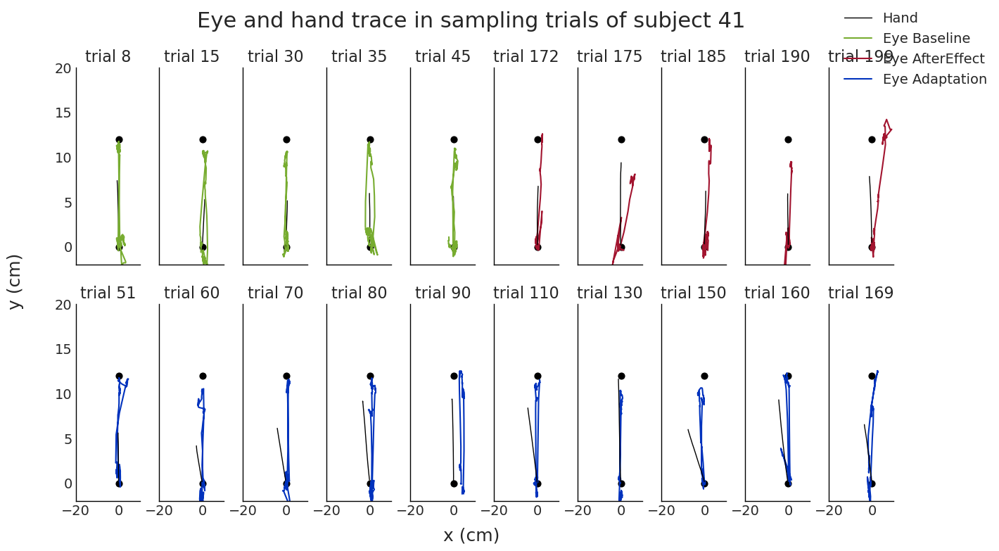

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


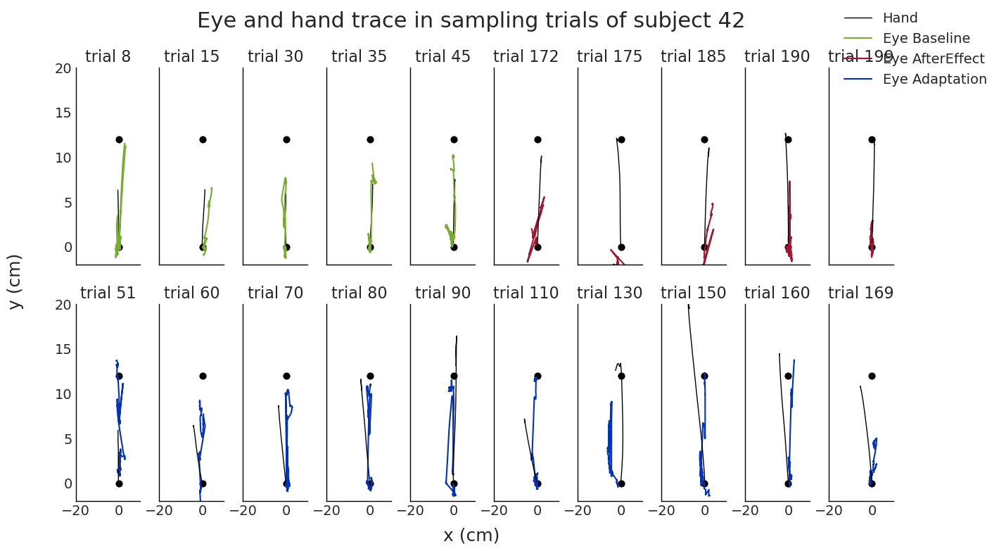

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


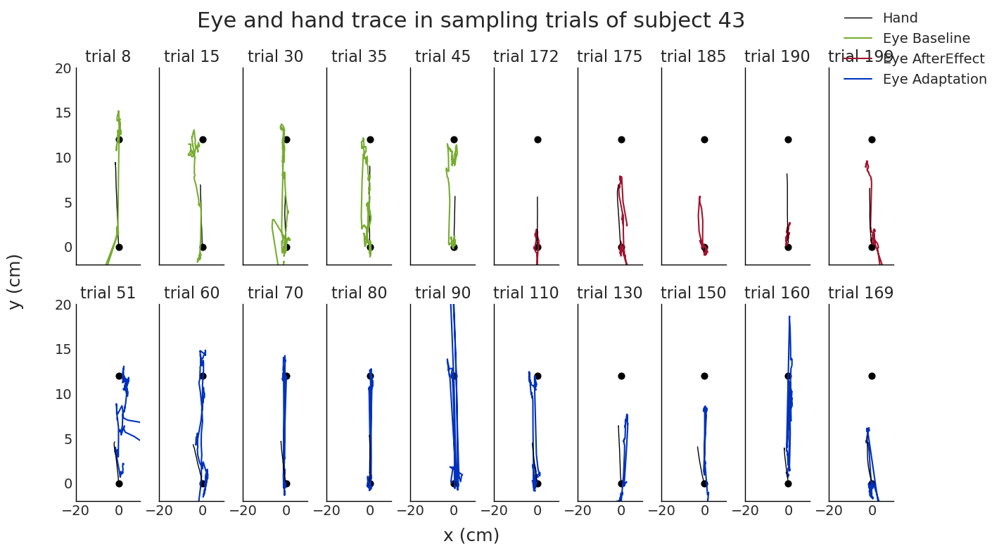

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


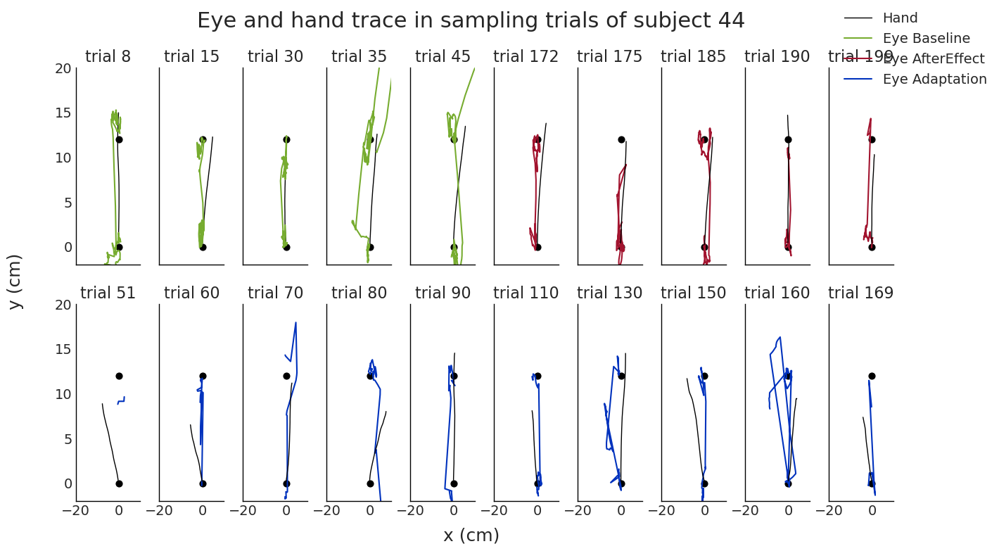

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


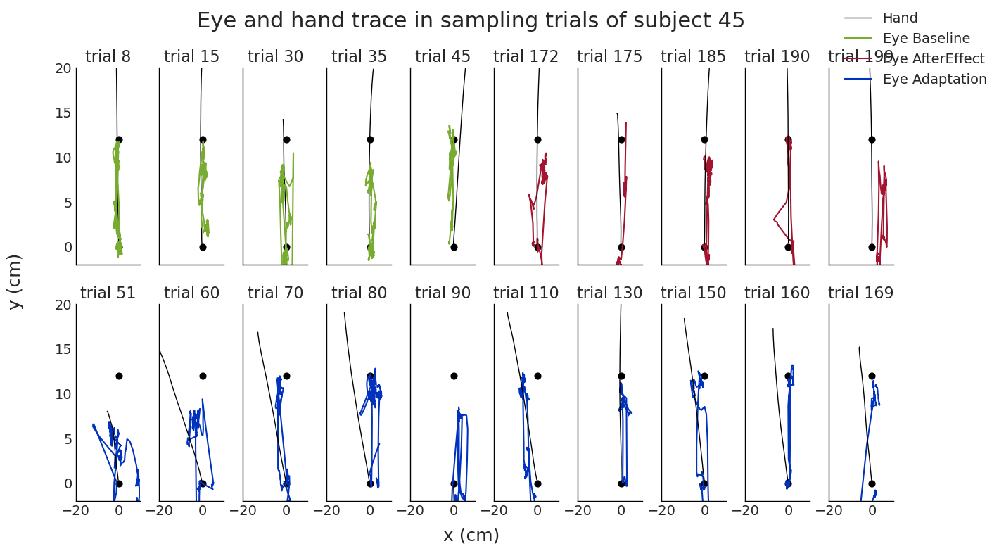

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


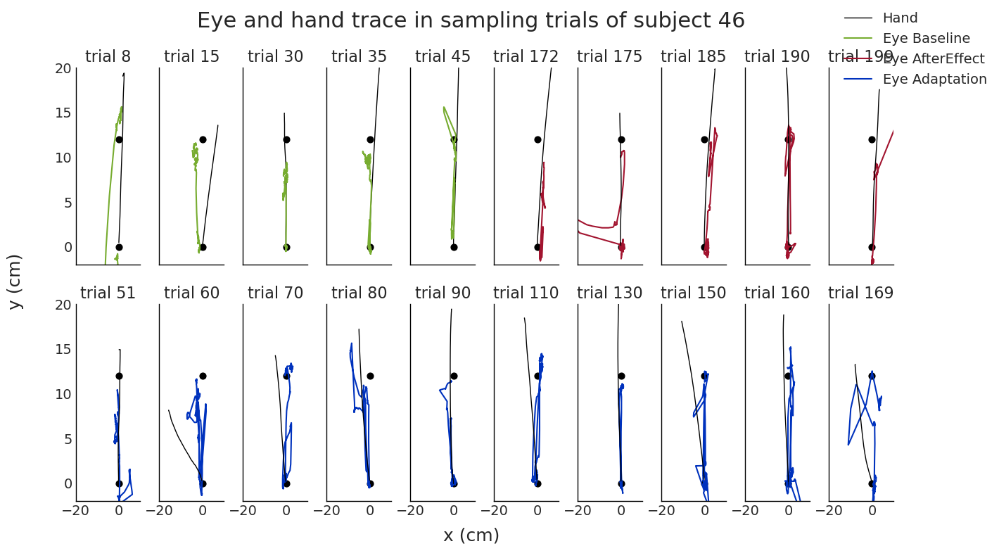

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


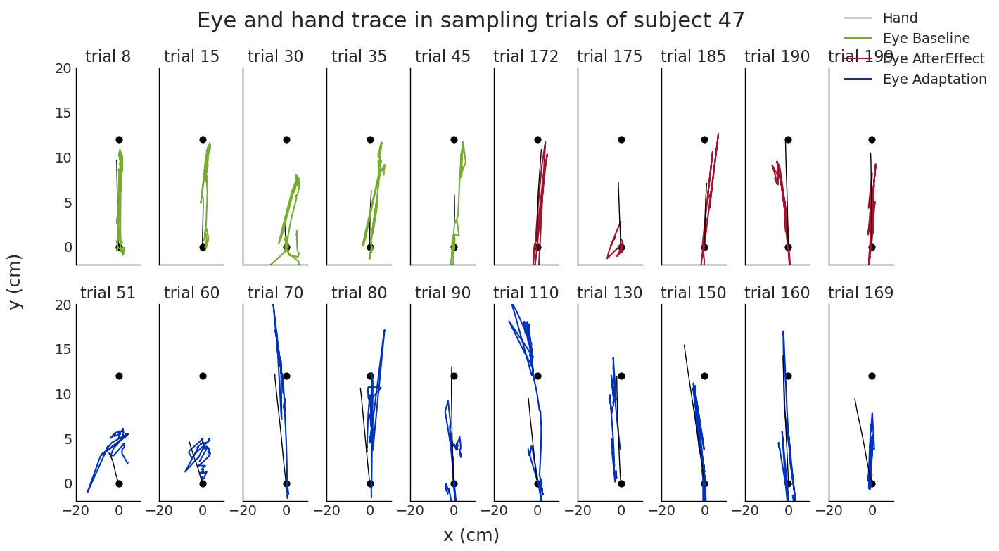

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


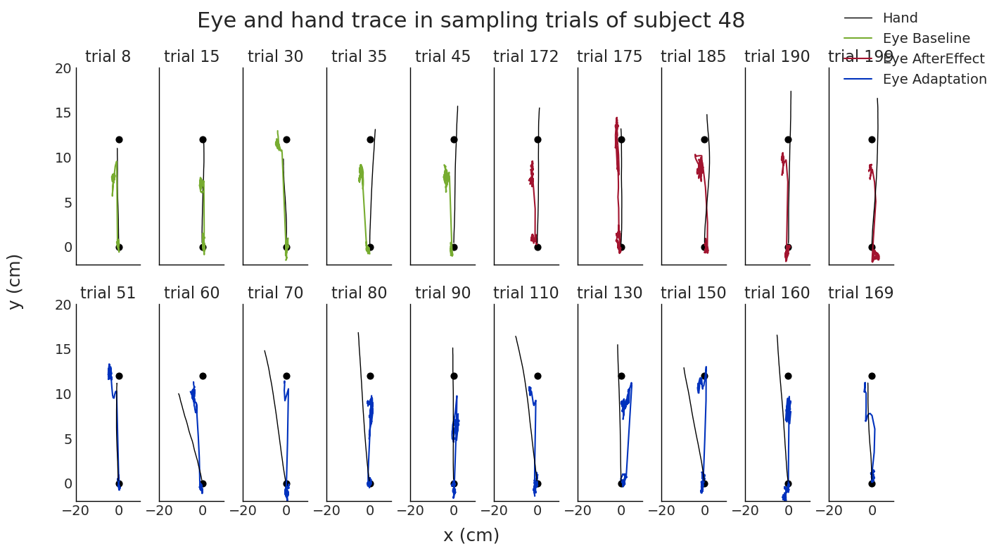

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


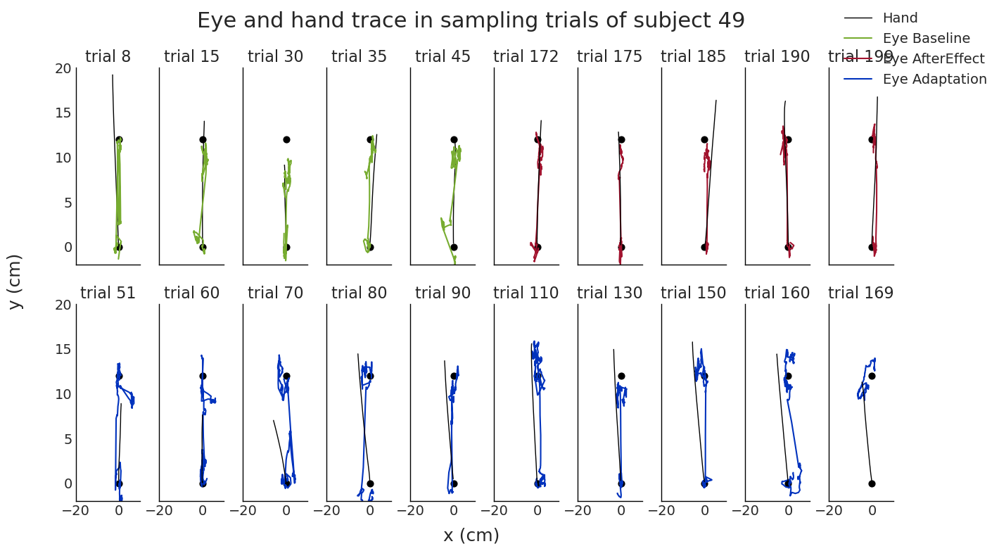

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


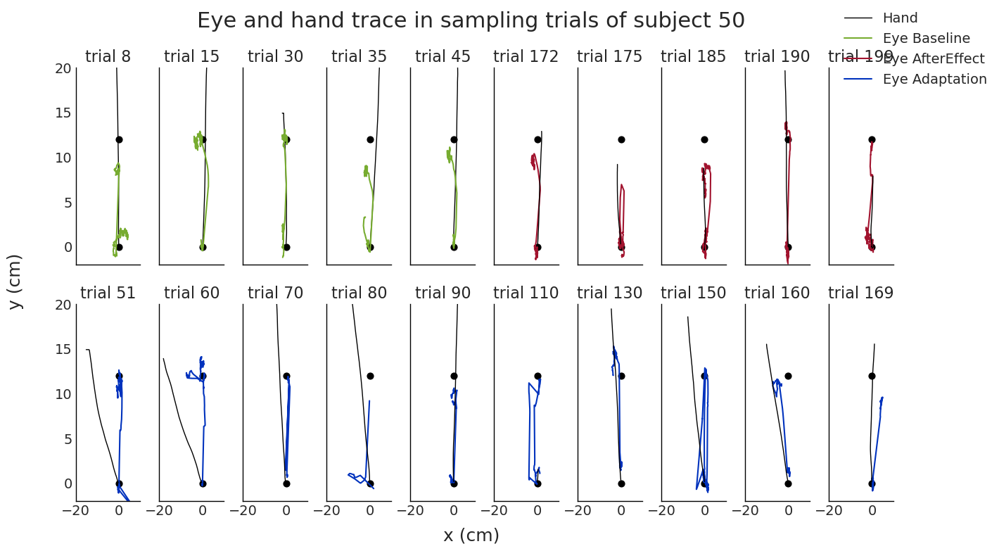

C:\Users\86178\AppData\Local\Temp\ipykernel_18876\1298701931.py:9: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.subplots_adjust(hspace=0.2, wspace=0.3)


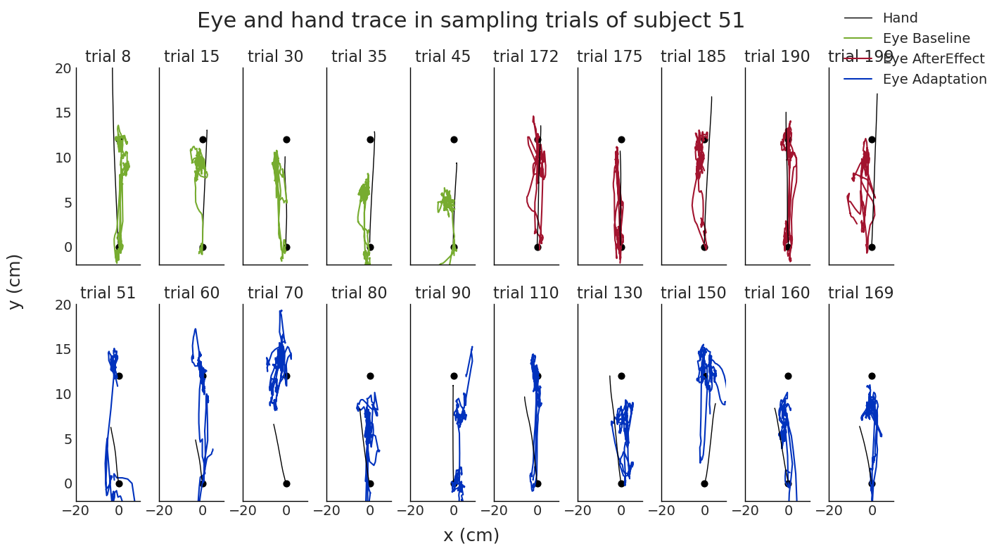

In [25]:
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():    
    rotated_hand = all_data[subj_id]['rotated_hand']
    gRotated = all_data[subj_id]['rotated_gaze']  
    
    rotated_hand_array = [np.array(trial) for trial in rotated_hand]
    
    fig, axs = plt.subplots(2, 10, figsize=(15, 8), sharex=True, sharey=True)
    fig.subplots_adjust(hspace=0.2, wspace=0.3)

    # BASELINE
    for i, thisTrialNum in enumerate([8, 15, 30, 35, 45], start=1):
        HAND, = axs[0, i-1].plot(rotated_hand_array[thisTrialNum][:, 0], rotated_hand_array[thisTrialNum][:, 1], color='k', linewidth=1)
        EYE_BA, = axs[0, i-1].plot(gRotated[:, thisTrialNum, 0], gRotated[:, thisTrialNum, 1], color="#77AC30")    
        axs[0, i-1].scatter([0, 0], [12, 0], 40, 'k')
        axs[0, i-1].set_xlim([-20, 20])
        axs[0, i-1].set_ylim([-2, 20])
        axs[0, i-1].set_title(f'trial {thisTrialNum}')

    # AE
    for i, thisTrialNum in enumerate([172, 175, 185, 190, 199], start=6):
        EYE_AE, = axs[0, i-1].plot(gRotated[:, thisTrialNum, 0], gRotated[:, thisTrialNum, 1], color="#A2142F")
        axs[0, i-1].plot(rotated_hand_array[thisTrialNum][:, 0], rotated_hand_array[thisTrialNum][:, 1], color='k', linewidth=1)
        axs[0, i-1].scatter([0, 0], [12, 0], 40, 'k')
        axs[0, i-1].set_xlim([-20, 20])
        axs[0, i-1].set_ylim([-2, 20])
        axs[0, i-1].set_title(f'trial {thisTrialNum}')

    # ADAPTATION
    for i, thisTrialNum in enumerate([51, 60, 70, 80, 90, 110, 130, 150, 160, 169], start=1):
        EYE_AD, = axs[1, i-1].plot(gRotated[:, thisTrialNum, 0], gRotated[:, thisTrialNum, 1], color="#0032BD")
        axs[1, i-1].plot(rotated_hand_array[thisTrialNum][:, 0], rotated_hand_array[thisTrialNum][:, 1], color='k', linewidth=1)
        axs[1, i-1].scatter([0, 0], [12, 0], 40, 'k')
        axs[1, i-1].set_xlim([-20, 10])
        axs[1, i-1].set_ylim([-2, 20])
        axs[1, i-1].set_title(f'trial {thisTrialNum}')

    fig.legend(handles=[HAND, EYE_BA, EYE_AE, EYE_AD], labels=['Hand', 'Eye Baseline', 'Eye AfterEffect', 'Eye Adaptation'], loc='upper right')
    plt.suptitle('Eye and hand trace in sampling trials of subject ' + subj_id, fontsize=22)
    fig.text(0.5, 0.04, 'x (cm)', ha='center', fontsize=18)
    fig.text(0.06, 0.5, 'y (cm)', va='center', rotation='vertical', fontsize=18)

#     # save
#     plt.savefig(os.path.join(output_folder, subj_id, subj_id + '_EyeHandTrace.png'))
    plt.show()

## plot hand and eye error

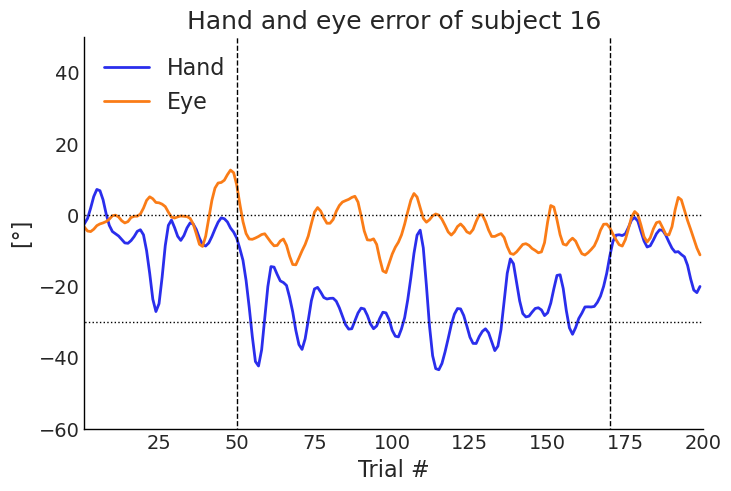

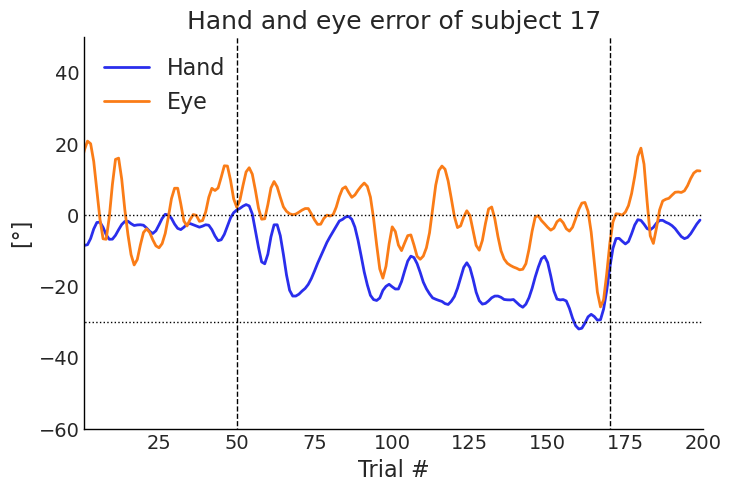

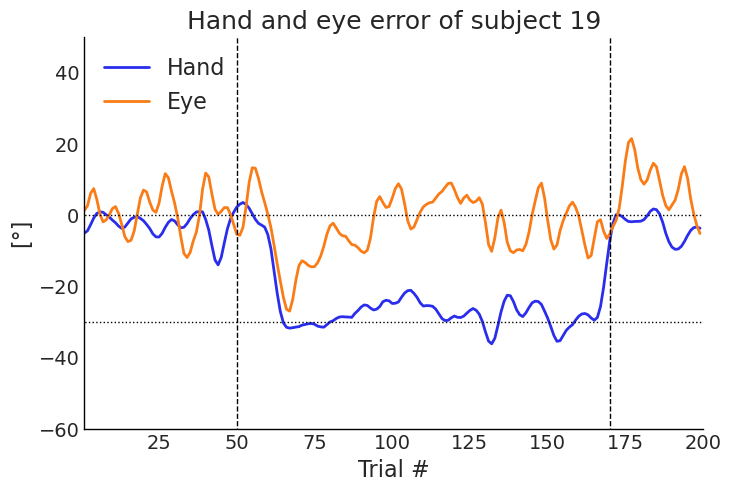

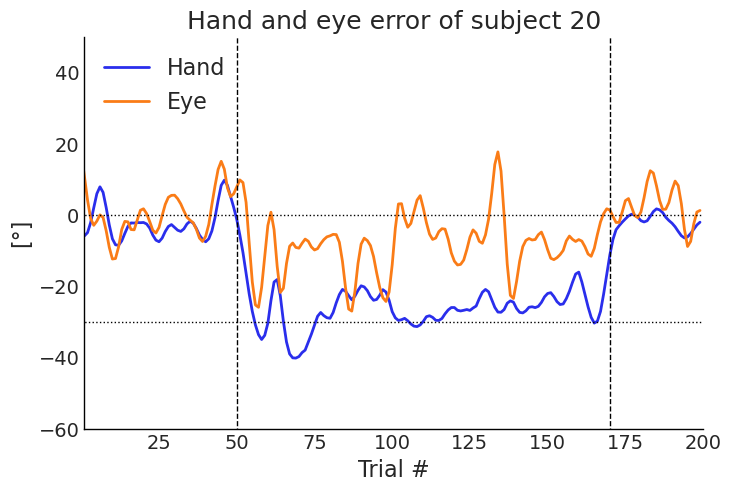

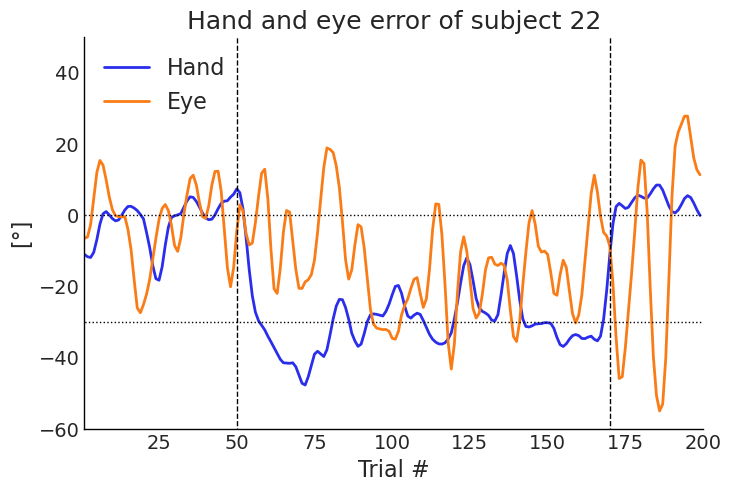

...

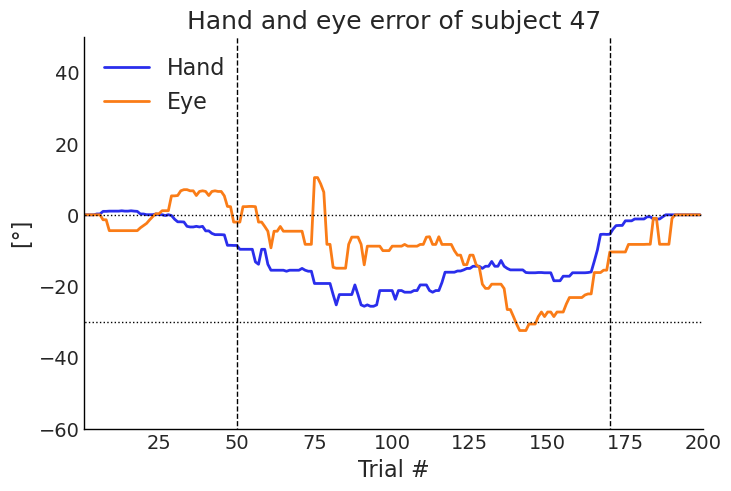

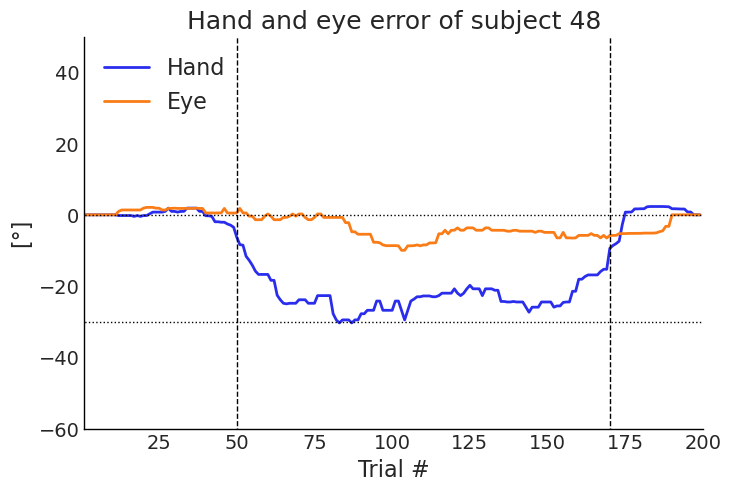

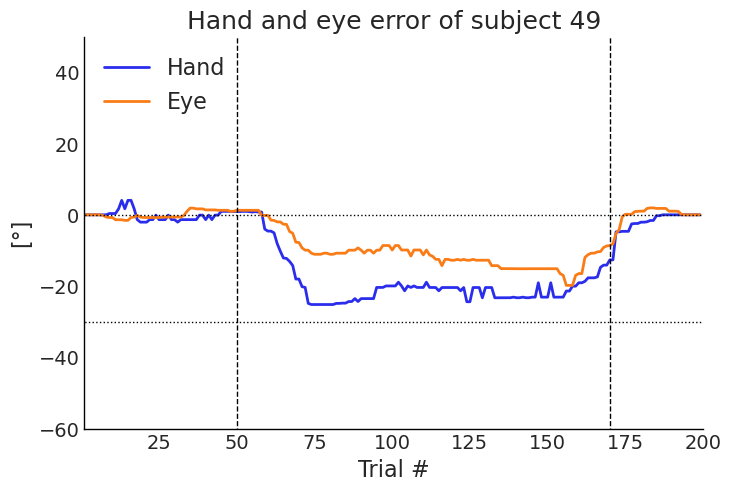

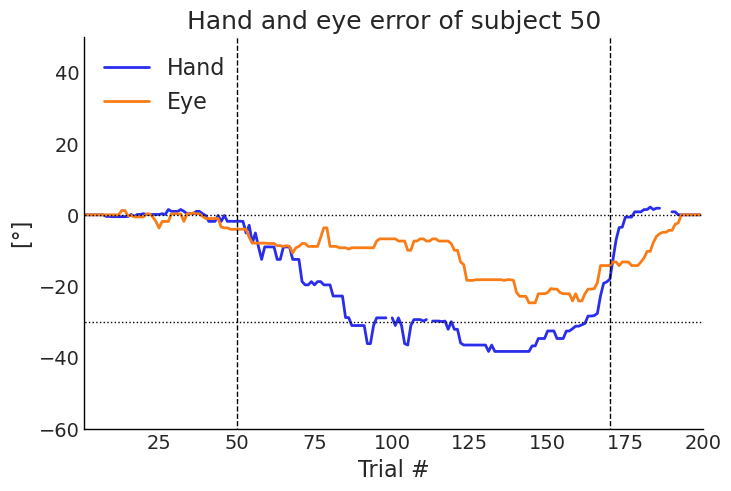

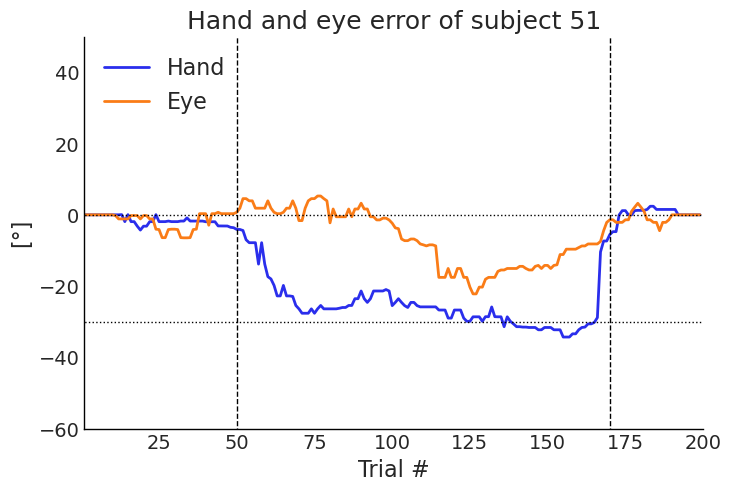

In [26]:
# Loop over all subjects in all_data dictionary
for subj_id in all_data.keys():    
    sm_handError = all_data[subj_id]['sm_handError'] 
    sm_eyeError = all_data[subj_id]['sm_eyeError']    
    
    plt.figure()
    plt.plot(sm_handError, linewidth=2)
    plt.plot(sm_eyeError, linewidth=2)
    plt.ylabel('[°]', fontsize=16)
    plt.xlabel('Trial #', fontsize=16)
    plt.title('Hand and eye error of subject '+ subj_id, fontsize=18)
    plt.ylim(-60, 50)
    plt.xlim(1, 200)
    plt.plot([50, 50], [-200, 200], 'k--', linewidth=1)
    plt.plot([170, 170], [-200, 200], 'k--', linewidth=1)
    plt.plot([0, 200], [0, 0], 'k:', linewidth=1)
    plt.plot([0, 200], [-30, -30], 'k:', linewidth=1)
    plt.legend(['Hand', 'Eye'], fontsize=16)
#     plt.grid(True, linestyle=':')
    plt.gca().tick_params(axis='both', which='major', labelsize=14)

#     # save
#     plt.savefig(os.path.join(output_folder, subj_id, subj_id + '_HandEyeErr.png'))
    plt.show()

In [27]:
# # save data frame
# if SaveAllData == 1:
#     file_path = 'all_data.pkl'
#     print('data saved')
#     with open(file_path, 'wb') as f:
#         pickle.dump(all_data, f)
    
    
#     file_path = 'dataTable_8T.pkl'
#     print('data saved')
#     with open(file_path, 'wb') as f:
#         pickle.dump(allTable, f)